<a href="https://colab.research.google.com/github/bwsi-hadr/2019-student-final-exercise/blob/master/Planning_Hayden_Maps_Final_exercise_grid.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
# need to specify location of some certificates for rasterio
!export CURL_CA_BUNDLE=/etc/ssl/certs/ca-certificates.crt
!sudo mkdir -p /etc/pki/tls/certs
!sudo cp /etc/ssl/certs/ca-certificates.crt /etc/pki/tls/certs/ca-bundle.crt
try:
  import rasterio
  import rasterio.plot
  import rasterio.merge 
  import rasterio.mask
except:
  !pip install rasterio
  import rasterio
  import rasterio.plot
  import rasterio.merge
  import rasterio.mask
  
try:
  import rasterstats as rs
except:
  !pip install rasterstats  
  import rasterstats as rs
  
try:
  import pyproj
except:
  !pip install pyproj
  import pyproj
  
import networkx as nx
try:
  import osmnx as ox
except:
  # osmnx depends on the system package libspatialindex
  !apt install libspatialindex-dev
  !pip install osmnx
  import osmnx as ox

try: 
  import geopandas as gpd
except: 
  !pip install geopandas 
  import geopandas as gpd
  
try:
  import contextily as ctx 
except:
  # install dependencies for contextily
  !apt install libproj-dev proj-data proj-bin
  !apt install libgeos-dev
  !pip install cython
  !pip install cartopy
  # install contextily
  !pip install contextily==1.0rc1 --no-use-pep517 --no-cache-dir
  import contextily as ctx
  
import fiona
from shapely.geometry import Point, LineString, Polygon
  
import gdal
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pathlib
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/'My Drive'/BWSI-Remote-Sensing/'Final_exercise'

     |████████████████████████████████| 19.7MB 2.8MB/s 
     |████████████████████████████████| 17.9MB 4.2MB/s 
     |████████████████████████████████| 81kB 24.4MB/s 
  Created wheel for simplejson: filename=simplejson-3.16.0-cp36-cp36m-linux_x86_64.whl size=114023 sha256=747f11256ffca66129ba0dc89c8d4d71fa7f41fb6d417a0242ac3fa3a94b8216
  Stored in directory: /root/.cache/pip/wheels/5d/1a/1e/0350bb3df3e74215cd91325344cc86c2c691f5306eb4d22c77
  Created wheel for munch: filename=munch-2.3.2-py2.py3-none-any.whl size=6613 sha256=76caed09086d7c7e3c6c7e2525936901fc049ebc0e13ef16441574203ed6e32e
  Stored in directory: /root/.cache/pip/wheels/db/bf/bc/06a3e1bfe0ab27d2e720ceb3cff3159398d92644c0cec2c125
Successfully built simplejson munch
     |████████████████████████████████| 11.2MB 2.8MB/s 
Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-410
Use 'apt 

In [3]:
!ls game_grid_export
!ls game2

facilities	      flooding.shx	       track.cpg
facilities_stats.csv  game_grid_all_stats.cpg  track.dbf
flooding.cpg	      game_grid_all_stats.dbf  track.prj
flooding.dbf	      game_grid_all_stats.prj  track.qpj
flooding.prj	      game_grid_all_stats.shp  track.shp
flooding.shp	      game_grid_all_stats.shx  track.shx
prep_turn_0  prep_turn_1  prep_turn_2  response_turn_0


#Turns

In [0]:
turn=0
original_grid=gpd.read_file('game_grid_export/game_grid_all_stats.shp')
game_grid=gpd.read_file('game2/response_turn_0/curr_grid.shp')
#game_grid

In [0]:
#original_grid=gpd.read_file('/content/original_grid.shp')
change=game_grid.copy()
change['Health']=game_grid['Health']-original_grid['Health']
change['Utility']=game_grid['Utility']-original_grid['Utility']
change['Transporta']=game_grid['Transporta']-original_grid['Transporta']

In [0]:
#game_grid

In [8]:
game_grid.loc[game_grid['Health']<7]

,Health,Utility,Transporta,geometry
0,1,10,6,POLYGON ((-71.79092278136125 42.58943590354409...
1,3,10,2,POLYGON ((-71.77874932612048 42.58973201162303...
2,1,10,5,POLYGON ((-71.76657568741803 42.59002682737616...
3,4,9,1,POLYGON ((-71.75440186615322 42.59032035170287...
4,2,10,1,POLYGON ((-71.74222786322531 42.59061258370377...
5,4,10,2,POLYGON ((-71.73005367863436 42.59090352427819...
6,2,10,1,POLYGON ((-71.71787931507833 42.59119317252686...
7,4,10,1,POLYGON ((-71.70570477165785 42.59148152844978...
9,6,10,1,POLYGON ((-71.68135515061971 42.59205436511684...
11,3,10,1,POLYGON ((-71.65700482181506 42.59262203248079...


In [0]:
flooding=gpd.read_file('game_grid_export/flooding.shp')

#Health

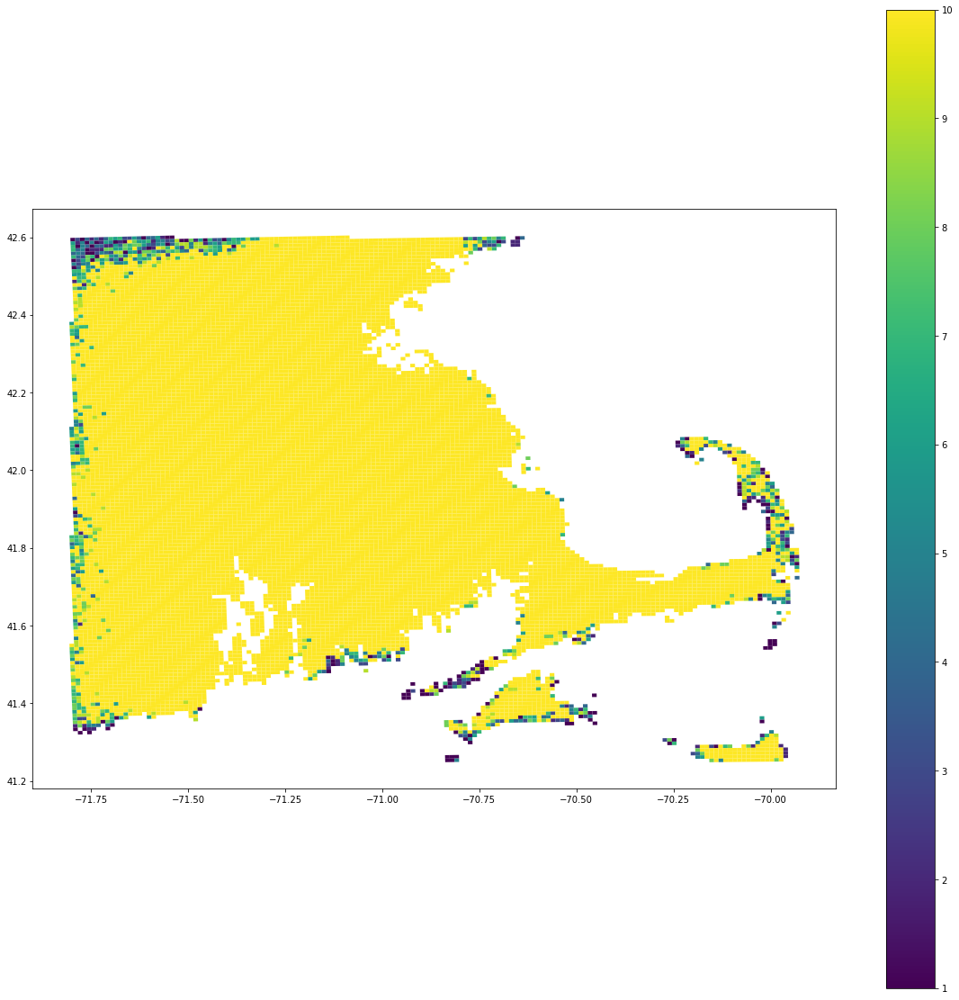

In [10]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Health', legend=True)

#Amount of People Dying
Can't account for evacuated/saved people

Don't use the data in areas that have been saved

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value inst

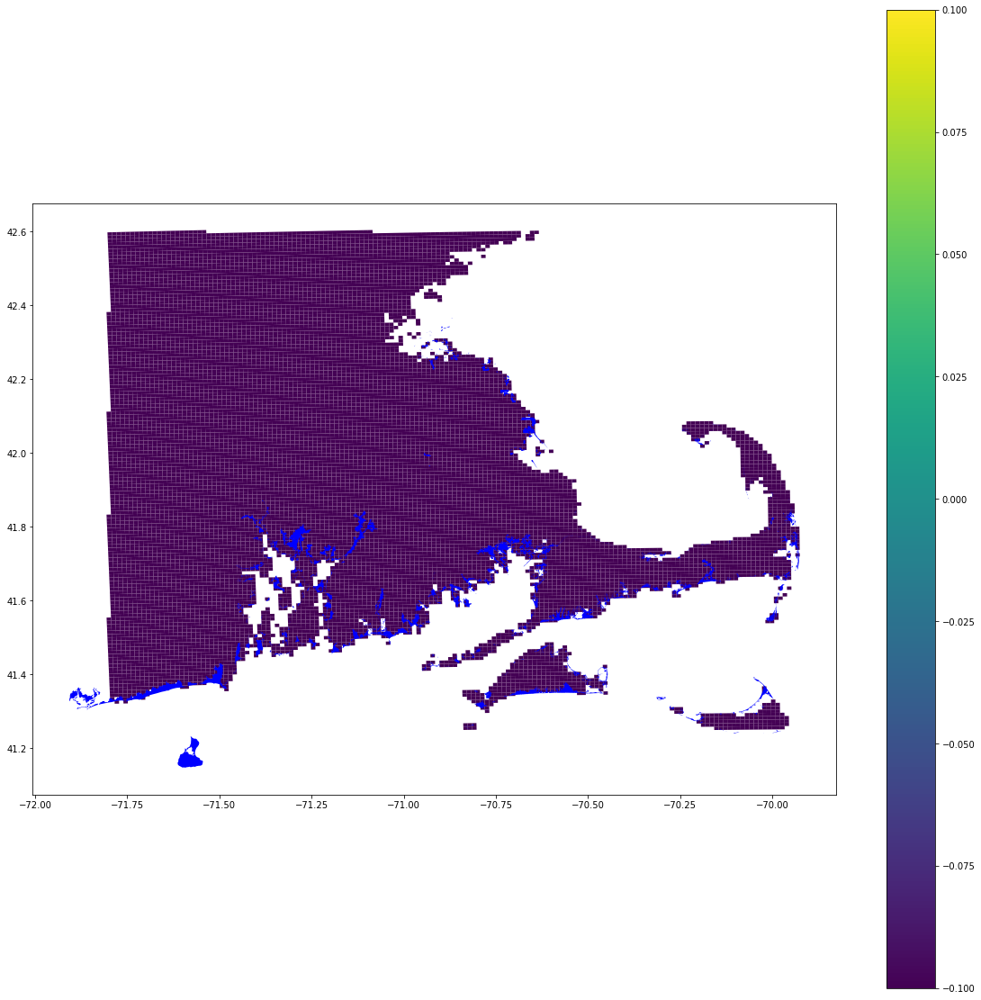

In [11]:
danger_grid=game_grid.copy()
danger_grid['danger']=0
danger_grid.loc[danger_grid['Health']>=9]['danger']=0
danger_grid.loc[danger_grid['Health']<9]['danger']=.0025
danger_grid.loc[danger_grid['Health']<7]['danger']=.005
danger_grid['danger']=original_grid['population']*danger_grid['danger']
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
danger_grid.plot(ax=ax, column='danger', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

In [0]:
#danger_grid

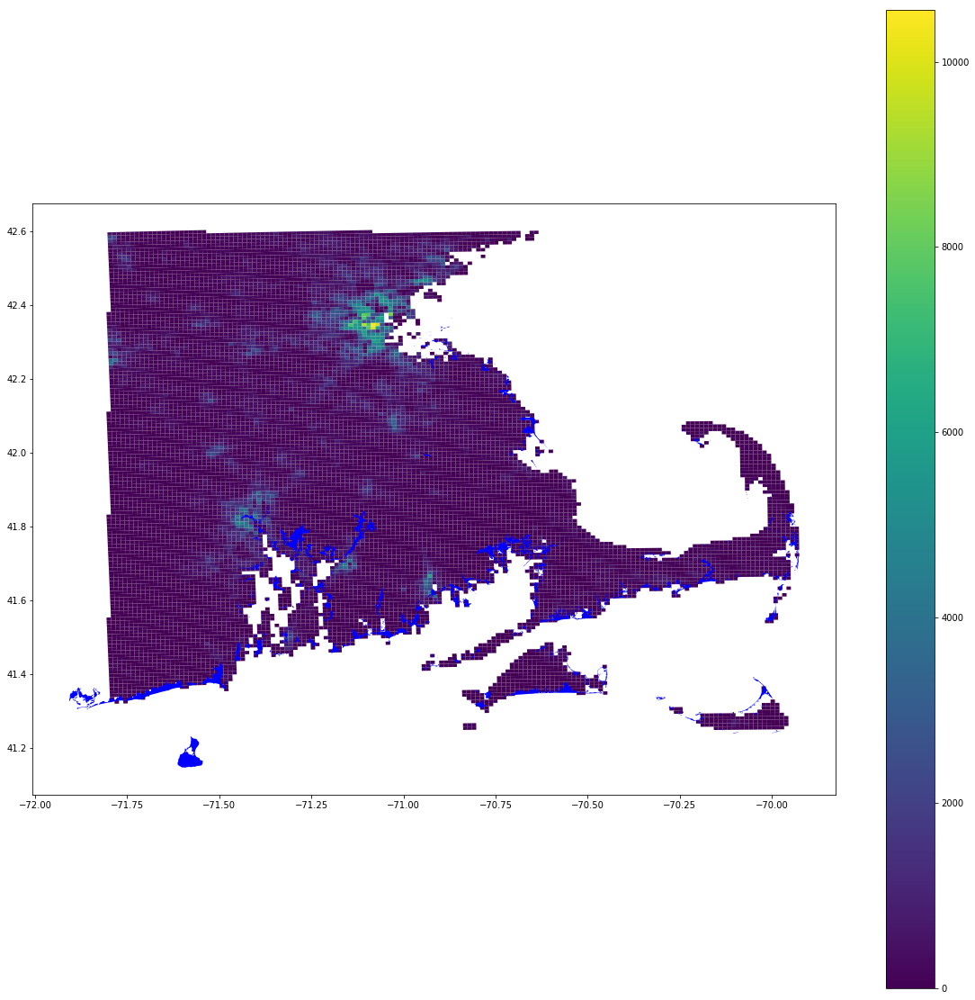

In [13]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
original_grid.plot(ax=ax, column='population', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

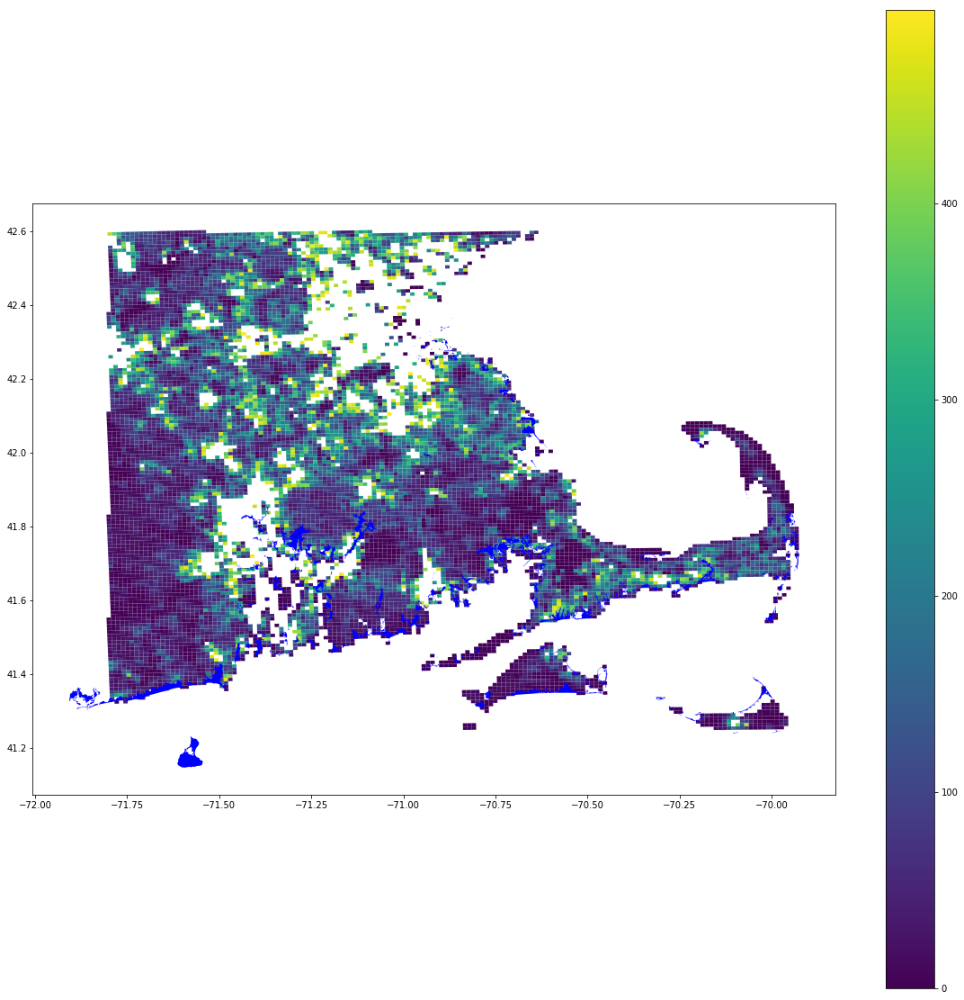

In [14]:
low_pop=original_grid.loc[original_grid['population']<500]
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
low_pop.plot(ax=ax, column='population', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

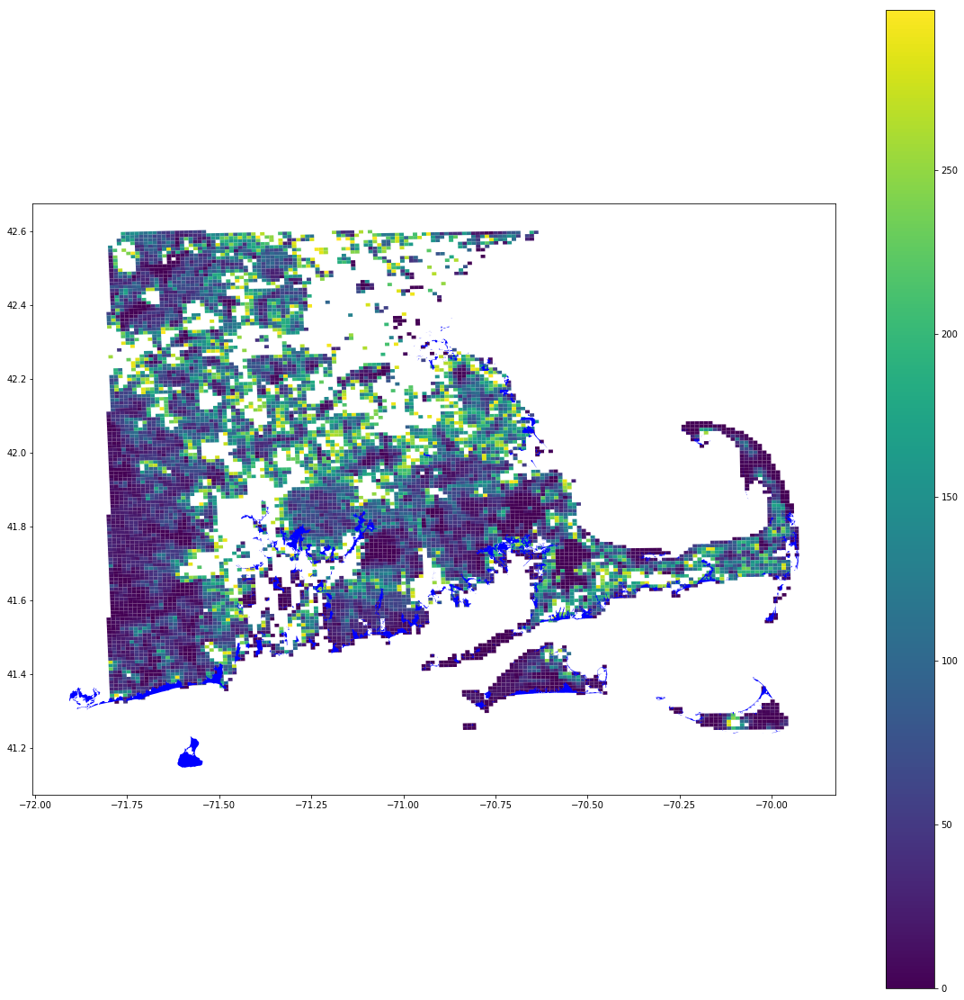

In [15]:
low_pop=original_grid.loc[original_grid['population']<300]
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
low_pop.plot(ax=ax, column='population', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

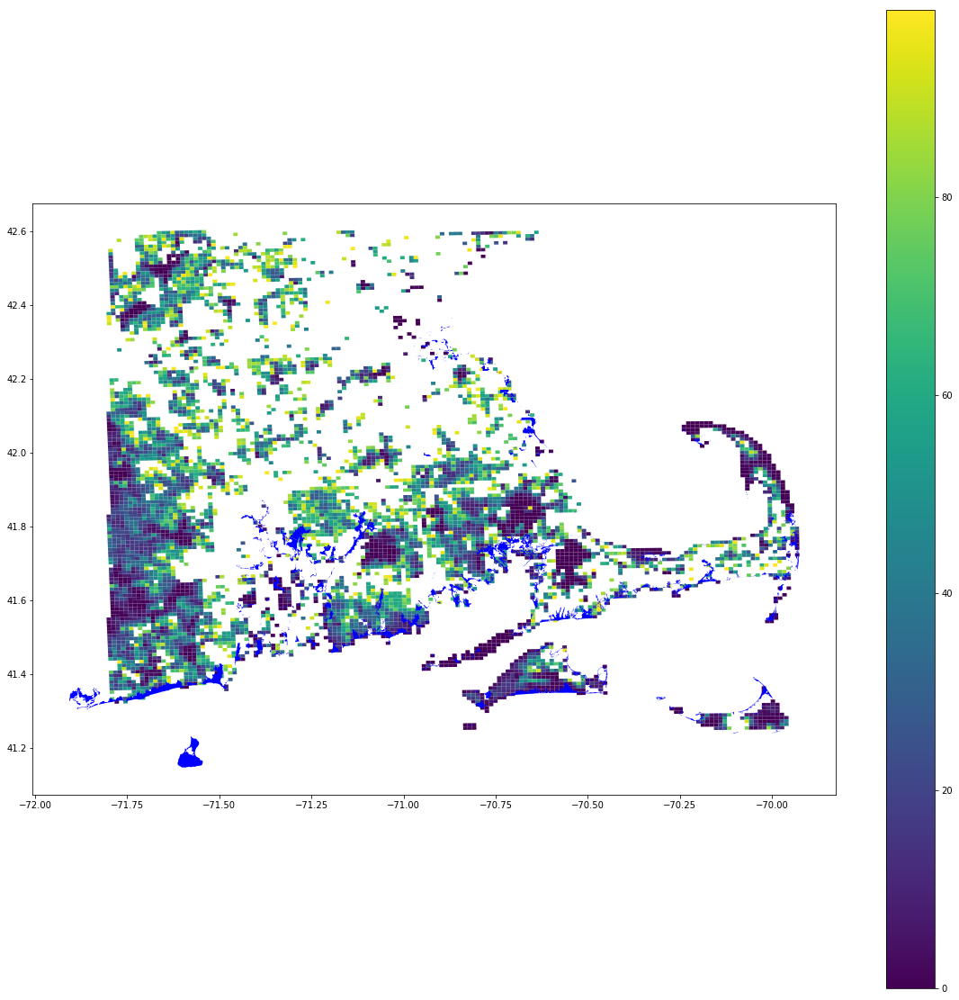

In [16]:
low_pop=original_grid.loc[original_grid['population']<100]
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
low_pop.plot(ax=ax, column='population', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

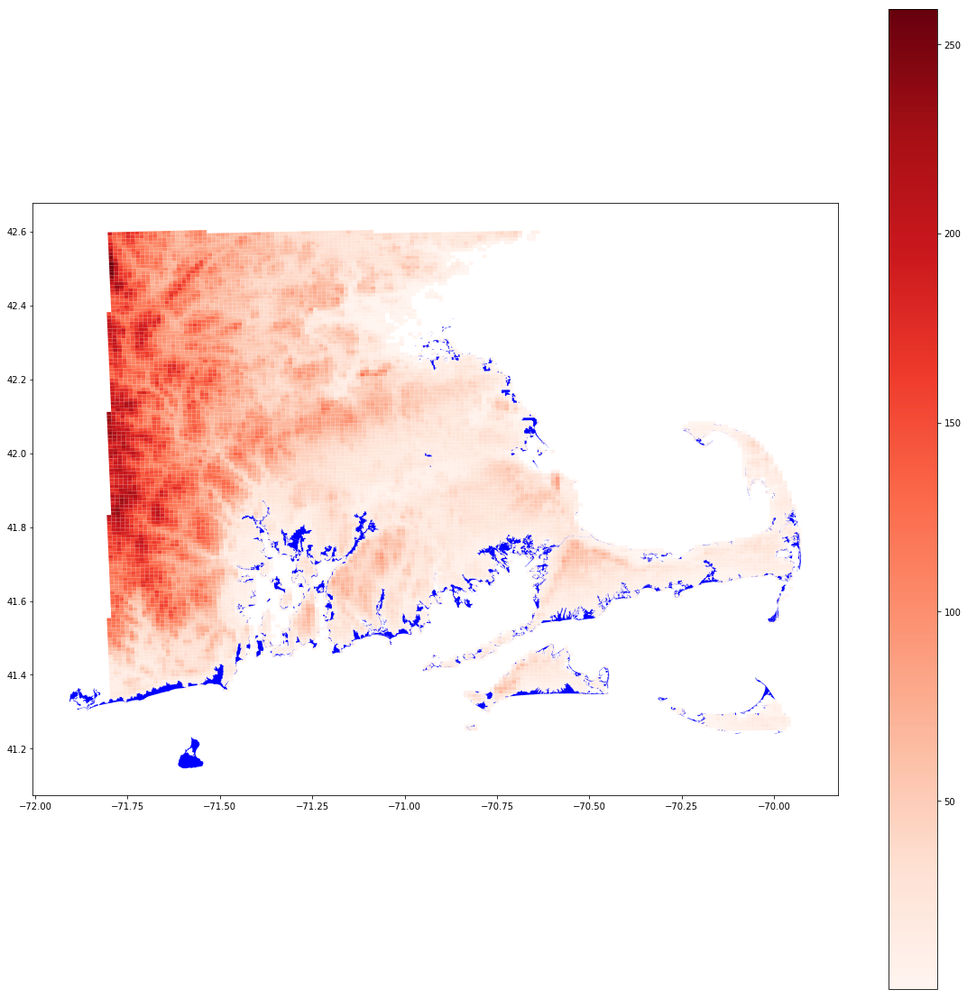

In [17]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
original_grid.plot(ax=ax, column='elevation', legend=True, cmap='Reds')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

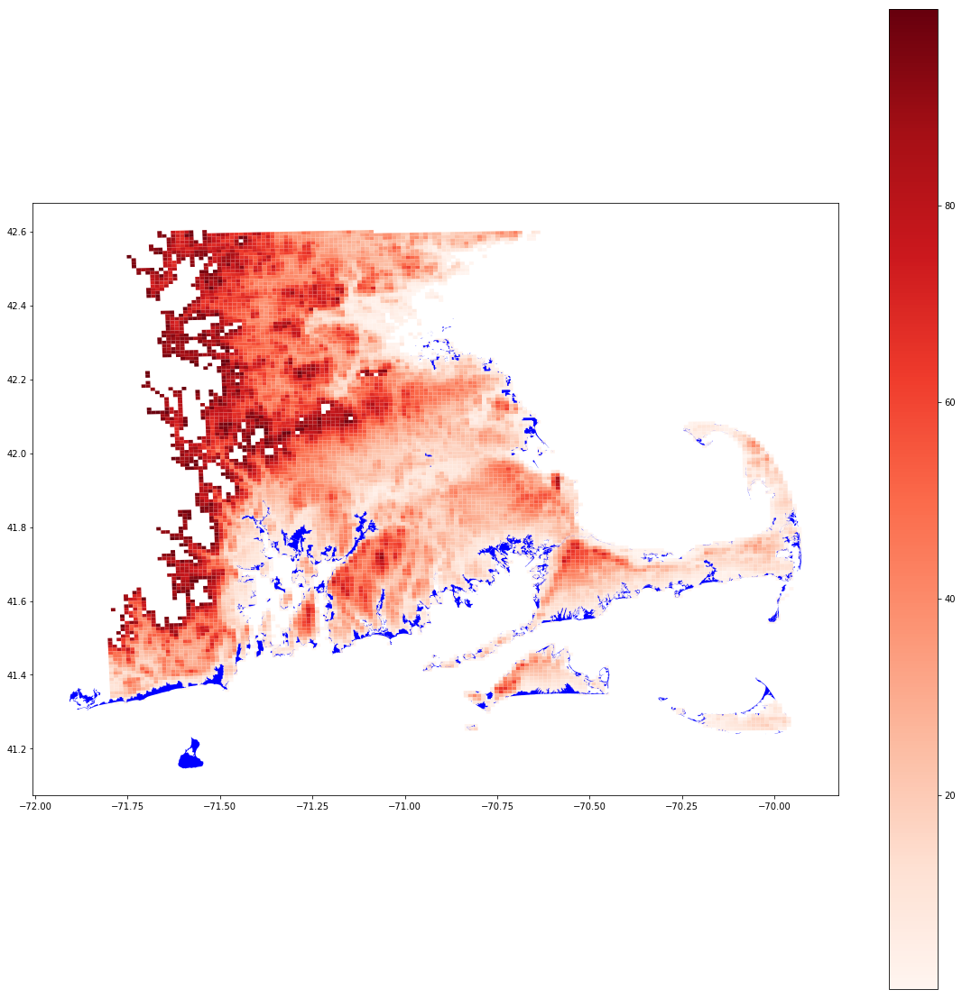

In [18]:
low=original_grid.loc[original_grid['elevation']<100]
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
low.plot(ax=ax, column='elevation', legend=True, cmap='Reds')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

In [0]:
status=gpd.read_file('game2/response_turn_{}/facilities_status.shp'.format(turn))

In [22]:
status

,objectid,type,facility,health_bon,utilities_,transport_,radius,health_inf,util_info,transpor_1,util_req,daily_food,daily_medi,daily_fuel,food_water,medicine,fuel,geometry
0,7519,airport,airport,0,0,0,0,0,0,0,6,0,0,30,0.0,0.0,0.0,POINT Z (-71.28900000034969 42.46994444468044 0)
1,7522,airport,airport,0,0,0,0,0,0,0,6,0,0,30,0.0,0.0,30.0,POINT Z (-71.02647222171561 41.8390555556694 0)
2,7524,airport,airport,0,0,0,0,0,0,0,6,0,0,30,0.0,0.0,0.0,POINT Z (-71.64173416709809 42.36759305587486 0)
3,7528,airport,airport,0,0,0,0,0,0,0,6,0,0,30,0.0,0.0,0.0,POINT Z (-71.00642380531434 42.36296502771393 0)
4,7550,airport,airport,0,0,0,0,0,0,0,6,0,0,30,0.0,0.0,0.0,POINT Z (-69.98963888852387 41.68830555555701 0)
5,7561,airport,airport,0,0,0,0,0,0,0,6,0,0,30,0.0,0.0,0.0,POINT Z (-70.52447055577147 41.35845055624821 0)
6,7563,airport,airport,0,0,0,0,0,0,0,6,0,0,30,0.0,0.0,60.0,POINT Z (-70.52280555633132 41.65913888864884 0)
7,7564,airport,airport,0,0,0,0,0,0,0,6,0,0,30,0.0,0.0,30.0,POINT Z (-70.54036111137617 41.58558333310441 0)
8,7575,airport,airport,0,0,0,0,0,0,0,6,0,0,30,0.0,0.0,0.0,POINT Z (-70.9094788888396 41.42233000012948 0)
9,7583,airport,airport,0,0,0,0,0,0,0,6,0,0,30,0.0,0.0,0.0,POINT Z (-70.83811111043934 42.02513888834909 0)


#Downloads for Colab

In [0]:
hospitals=gpd.read_file('game_grid_export/facilities/hospitals.shp')
shelters=gpd.read_file('game_grid_export/facilities/shelters.shp')
plants=gpd.read_file('game_grid_export/facilities/powerplants.shp')
towers=gpd.read_file('game_grid_export/facilities/cell_towers.shp')
stations=gpd.read_file('game_grid_export/facilities/fire_stations.shp')
local_eo=gpd.read_file('game_grid_export/facilities/local_eocs.shp')
state_eo=gpd.read_file('game_grid_export/facilities/state_eocs.shp')
big_hospitals=hospitals[hospitals['BEDS']>=200]
small_hospitals=hospitals[hospitals['BEDS']<200]
EMS=gpd.read_file('game_grid_export/facilities/EMS.shp')
big_EMS=EMS[EMS['TOTAL_VEHI']>=5]
small_EMS=EMS[EMS['TOTAL_VEHI']<5]
change=game_grid.copy()
change['Health']=game_grid['Health']-original_grid['Health']
change['Utility']=game_grid['Utility']-original_grid['Utility']
change['Transporta']=game_grid['Transporta']-original_grid['Transporta']
airfields=gpd.read_file('game_grid_export/facilities/airfields.shp')

In [0]:
big_hospitals_data=gpd.sjoin(big_hospitals, game_grid)
#big_hospitals_data=gpd.sjoin(big_hospitals, game_grid)
eff_big_hospitals=big_hospitals_data[big_hospitals_data['Utility']>=8]
dead_big_hospitals=big_hospitals_data[big_hospitals_data['Utility']<8]
small_hospitals_data=gpd.sjoin(small_hospitals, game_grid)
eff_small_hospitals=small_hospitals_data[small_hospitals_data['Utility']>=7]
dead_small_hospitals=small_hospitals_data[small_hospitals_data['Utility']<7]
big_EMS_data=gpd.sjoin(big_EMS, game_grid)
eff_big_EMS=big_EMS_data[big_EMS_data['Utility']>=6]
dead_big_EMS=big_EMS_data[big_EMS_data['Utility']<6]
small_EMS_data=gpd.sjoin(small_EMS, game_grid)
eff_small_EMS=small_EMS_data[small_EMS_data['Utility']>=6]
dead_small_EMS=small_EMS_data[small_EMS_data['Utility']<6]
plants_data=gpd.sjoin(plants, game_grid)
eff_plants=plants_data[plants_data['Utility']>=3]
dead_plants=plants_data[plants_data['Utility']<3]
stations_data=gpd.sjoin(stations, game_grid)
eff_stations=stations_data[stations_data['Utility']>=7]
dead_stations=stations_data[stations_data['Utility']<7]
towers_data=gpd.sjoin(towers, game_grid)
eff_towers=towers_data[towers_data['Utility']>=8]
dead_towers=towers_data[towers_data['Utility']<8]
shelters_data=gpd.sjoin(shelters, game_grid)
eff_shelters=shelters_data[shelters_data['Utility']>=3]
dead_shelters=shelters_data[shelters_data['Utility']<3]
airfields_data=gpd.sjoin(airfields, game_grid)
eff_airfields=airfields_data[airfields_data['Utility']>=6]
dead_airfields=airfields_data[airfields_data['Utility']<6]
lcl_eo_data=gpd.sjoin(local_eo, game_grid)
eff_lcl_eo=lcl_eo_data[lcl_eo_data['Utility']>=6]
dead_lcl_eo=lcl_eo_data[lcl_eo_data['Utility']<6]
stt_eo_data=gpd.sjoin(state_eo, game_grid)
eff_stt_eo=stt_eo_data[stt_eo_data['Utility']>=7]
dead_stt_eo=stt_eo_data[stt_eo_data['Utility']<7]

In [0]:
big_hospitals_data2=gpd.sjoin(big_hospitals, status.loc[status['type']=='hospital_l'])
del big_hospitals_data2['index_right']
ws_big_hospitals=big_hospitals_data2[np.logical_and(big_hospitals_data2['food_water']>=100, big_hospitals_data2['medicine']>=100)]
oos_big_hospitals=big_hospitals_data2[np.logical_or(big_hospitals_data2['food_water']<100, big_hospitals_data2['medicine']<100)]
small_hospitals_data2=gpd.sjoin(small_hospitals, status.loc[status['type']=='hospital_s'])
del small_hospitals_data2['index_right']
ws_small_hospitals=small_hospitals_data2[np.logical_and(small_hospitals_data2['food_water']>=50, small_hospitals_data2['medicine']>=50)]
oos_small_hospitals=small_hospitals_data2[np.logical_and(small_hospitals_data2['food_water']<50, small_hospitals_data2['medicine']<50)]
big_EMS_data2=gpd.sjoin(big_EMS, status.loc[status['type']=='ems_l'])
del big_EMS_data2['index_right']
ws_big_EMS=big_EMS_data2[big_EMS_data2['medicine']>=50]
oos_big_EMS=big_EMS_data2[big_EMS_data2['medicine']<50]
small_EMS_data2=gpd.sjoin(small_EMS, status.loc[status['type']=='ems_s'])
del small_EMS_data2['index_right']
ws_small_EMS=small_EMS_data2[small_EMS_data2['medicine']>=25]
oos_small_EMS=small_EMS_data2[small_EMS_data2['medicine']<25]
plants_data2=gpd.sjoin(plants, status.loc[status['type']=='power_plant'])
del plants_data2['index_right']
ws_plants=plants_data2[plants_data2['fuel']>=100]
oos_plants=plants_data2[plants_data2['fuel']<100]
shelters_data2=gpd.sjoin(shelters, status.loc[status['type']=='shelter'])
del shelters_data2['index_right']
ws_shelters=shelters_data2[shelters_data2['food_water']>=100]
oos_shelters=shelters_data2[shelters_data2['food_water']<100]
airfields_data2=gpd.sjoin(airfields, status.loc[status['type']=='helipad'])
del airfields_data2['index_right']
ws_airfields=airfields_data2[airfields_data2['fuel']>=30]
oos_airfields=airfields_data2[airfields_data2['fuel']<30]

In [0]:
big_hospitals_data3=gpd.sjoin(big_hospitals_data2, game_grid)
w_big_hospitals=big_hospitals_data3[np.logical_and(big_hospitals_data3['Utility']>=8, np.logical_and(big_hospitals_data3['food_water']>=100, big_hospitals_data3['medicine']>=100))]
nw_big_hospitals=big_hospitals_data3[np.logical_or(big_hospitals_data3['Utility']<8, np.logical_or(big_hospitals_data3['food_water']<100, big_hospitals_data3['medicine']<100))]
small_hospitals_data3=gpd.sjoin(small_hospitals_data2, game_grid)
w_small_hospitals=small_hospitals_data3[np.logical_and(small_hospitals_data3['Utility']>=7, np.logical_and(small_hospitals_data3['food_water']>=50, small_hospitals_data3['medicine']>=50))]
nw_small_hospitals=small_hospitals_data3[np.logical_or(small_hospitals_data3['Utility']<7, np.logical_or(small_hospitals_data3['food_water']<50, small_hospitals_data3['medicine']<50))]
big_EMS_data3=gpd.sjoin(big_EMS_data2, game_grid)
w_big_EMS=big_EMS_data3[np.logical_and(big_EMS_data3['Utility']>=6, big_EMS_data3['medicine']>=50)]
nw_big_EMS=big_EMS_data3[np.logical_or(big_EMS_data3['Utility']<6, big_EMS_data3['medicine']<50)]
small_EMS_data3=gpd.sjoin(big_EMS_data2, game_grid)
w_small_EMS=small_EMS_data3[np.logical_and(small_EMS_data3['Utility']>=6, small_EMS_data3['medicine']>=25)]
nw_small_EMS=small_EMS_data3[np.logical_or(small_EMS_data3['Utility']<6, small_EMS_data3['medicine']<25)]
plants_data3=gpd.sjoin(plants_data2,game_grid)
w_plants=plants_data3[np.logical_and(plants_data3['fuel']>=100, plants_data3['Utility']>=3)]
nw_plants=plants_data3[np.logical_or(plants_data3['fuel']<100, plants_data3['Utility']<3)]
shelters_data3=gpd.sjoin(shelters_data2, game_grid)
w_shelters=shelters_data3[np.logical_and(shelters_data3['Utility']>=3, shelters_data3['food_water']>=100)]
nw_shelters=shelters_data3[np.logical_or(shelters_data3['Utility']<3, shelters_data3['food_water']<100)]
airfields_data3=gpd.sjoin(airfields_data2, game_grid)
w_airfields=airfields_data3[np.logical_and(airfields_data3['Utility']>=6, airfields_data3['fuel']>=30)]
nw_airfields=airfields_data3[np.logical_or(airfields_data3['Utility']<6, airfields_data3['fuel']<30)]

#Dead Facilities
The files are in content under the files tab to the right

Dead is defined by not having enough utility, it does not include facilities that have run out of resources.

In [0]:
dead_big_hospitals.to_csv('/content/dead_big_hospitals.csv')
dead_small_hospitals.to_csv('/content/dead_small_hospitals.csv')
dead_big_EMS.to_csv('/content/dead_big_EMS.csv')
dead_small_EMS.to_csv('/content/dead_small_EMS.csv')
dead_stt_eo.to_csv('/content/dead_stt_eo.csv')
dead_lcl_eo.to_csv('/content/dead_lcl_eo.csv')
#dead_plants.to_csv('/content/dead_plants.csv')
dead_towers.to_csv('/content/dead_towers.csv')
dead_stations.to_csv('/content/dead_stations.csv')
#dead_shelters.to_csv('/content/dead_shelters.csv')
dead_airfields.to_csv('/content/dead_airfields.csv')

#Functioning Facilities
The files are in content under the files tab to the right

May include facilities that have run out of supplies.

In [0]:
eff_big_hospitals.to_csv('/content/eff_big_hospitals.csv')
eff_small_hospitals.to_csv('/content/eff_small_hospitals.csv')
eff_big_EMS.to_csv('/content/eff_big_EMS.csv')
eff_small_EMS.to_csv('/content/eff_small_EMS.csv')
eff_stt_eo.to_csv('/content/eff_stt_eo.csv')
eff_lcl_eo.to_csv('/content/eff_lcl_eo.csv')
eff_plants.to_csv('/content/eff_plants.csv')
eff_towers.to_csv('/content/eff_towers.csv')
eff_stations.to_csv('/content/eff_stations.csv')
eff_shelters.to_csv('/content/eff_shelters.csv')
eff_airfields.to_csv('/content/eff_airfields.csv')

#Facilities Out of Supplies

In [0]:
oos_big_hospitals.to_csv('/content/oos_big_hospitals.csv')
oos_small_hospitals.to_csv('/content/oos_small_hospitals.csv')
oos_big_EMS.to_csv('/content/oos_big_EMS.csv')
oos_small_EMS.to_csv('/content/oos_small_EMS.csv')
oos_plants.to_csv('/content/oos_plants.csv')
oos_shelters.to_csv('/content/oos_shelters.csv')
oos_airfields.to_csv('/content/oos_airfields.csv')

#Facilities With Supplies

In [0]:
ws_big_hospitals.to_csv('/content/ws_big_hospitals.csv')
ws_small_hospitals.to_csv('/content/ws_small_hospitals.csv')
ws_big_EMS.to_csv('/content/ws_big_EMS.csv')
ws_small_EMS.to_csv('/content/ws_small_EMS.csv')
ws_plants.to_csv('/content/ws_plants.csv')
ws_shelters.to_csv('/content/ws_shelters.csv')
ws_airfields.to_csv('/content/ws_airfields.csv')

#Facilities Not Working

In [0]:
nw_big_hospitals.to_csv('/content/nw_big_hospitals.csv')
nw_small_hospitals.to_csv('/content/nw_small_hospitals.csv')
nw_big_EMS.to_csv('/content/nw_big_EMS.csv')
nw_small_EMS.to_csv('/content/nw_small_EMS.csv')
nw_plants.to_csv('/content/nw_plants.csv')
nw_shelters.to_csv('/content/nw_shelters.csv')
nw_airfields.to_csv('/content/nw_airfields.csv')

#Facilities Working

In [0]:
w_big_hospitals.to_csv('/content/w_big_hospitals.csv')
w_small_hospitals.to_csv('/content/w_small_hospitals.csv')
w_big_EMS.to_csv('/content/w_big_EMS.csv')
w_small_EMS.to_csv('/content/w_small_EMS.csv')
w_plants.to_csv('/content/w_plants.csv')
w_shelters.to_csv('/content/w_shelters.csv')
w_airfields.to_csv('/content/w_airfields.csv')

In [0]:
#print(len(hospitals))
#print(len(small_hospitals))
#print(len(big_hospitals))
#print(len(plants))
#print(len(towers))
#print(len(stations))
#print(len(local_eo))
#print(len(state_eo))
#print(len(small_EMS))
#print(len(big_EMS))

#Utility

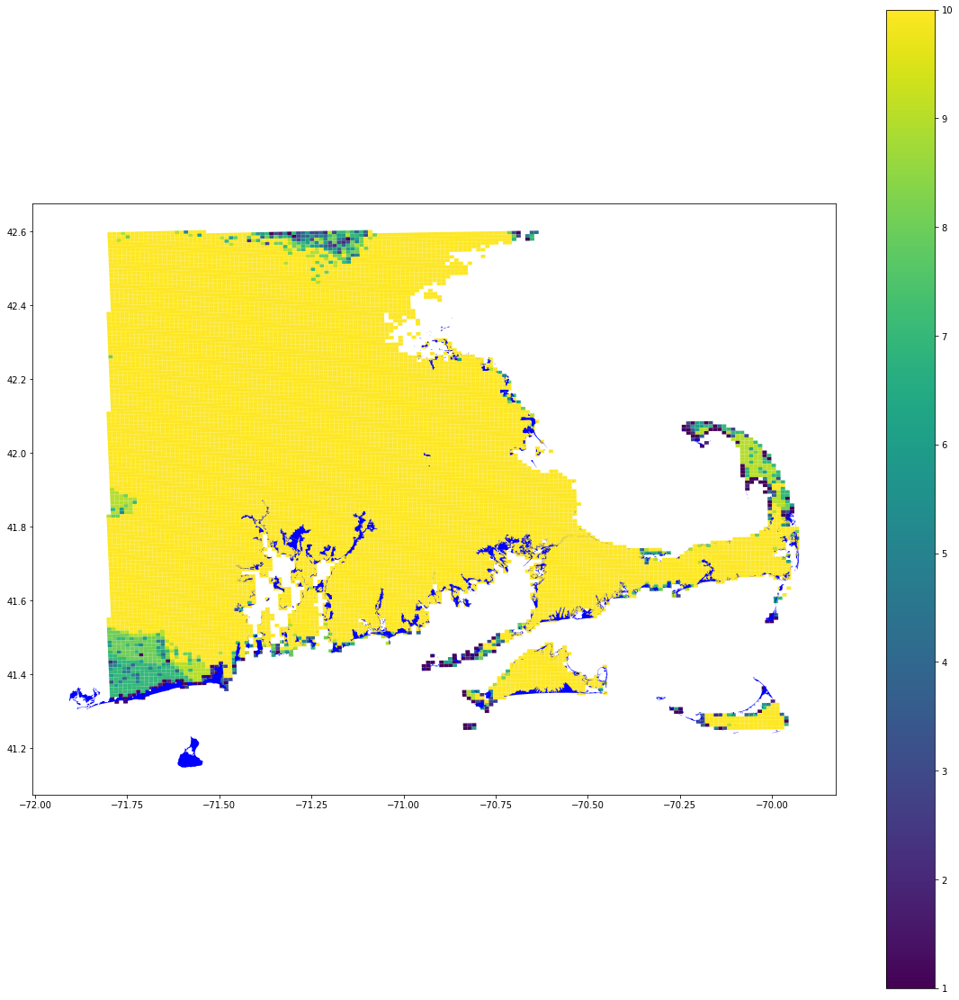

In [34]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)

In [0]:
#flood_pop=gpd.sjoin(flooding, game_grid)
#flood_pop

#All Facilities

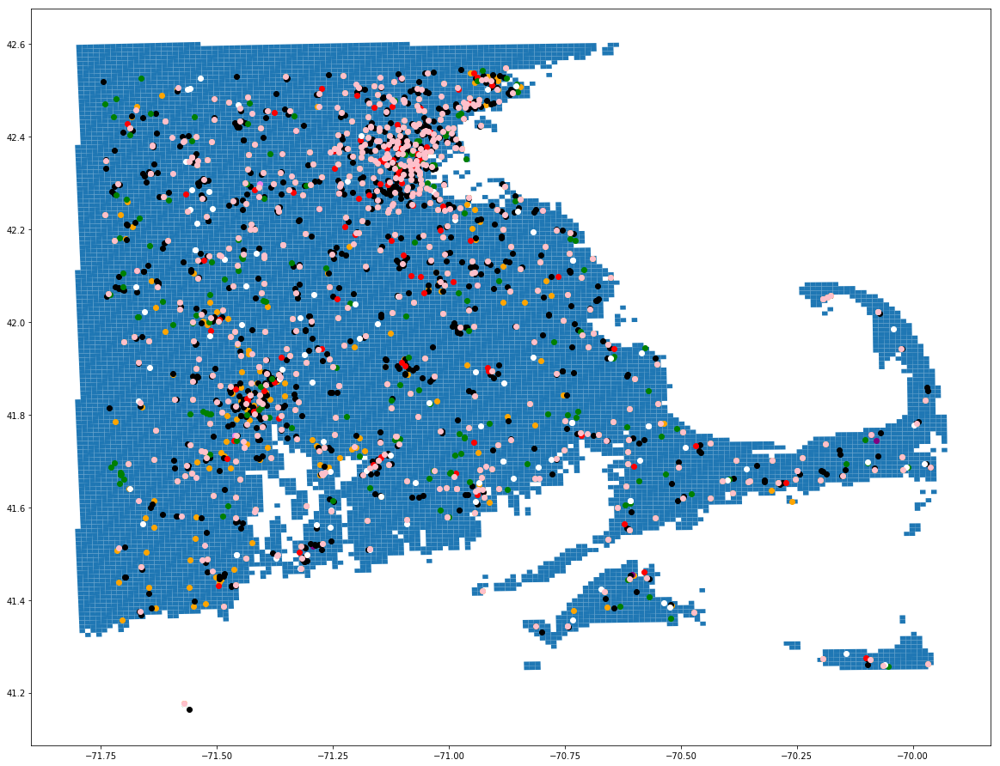

In [36]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)
plants.to_crs(game_grid.crs).plot(color='green', ax=ax, zorder=15)
towers.to_crs(game_grid.crs).plot(color='white', ax=ax, zorder=15)
stations.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5)
local_eo.to_crs(game_grid.crs).plot(color='purple', ax=ax, zorder=5)
state_eo.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)
EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)

All Functioning Facilities 

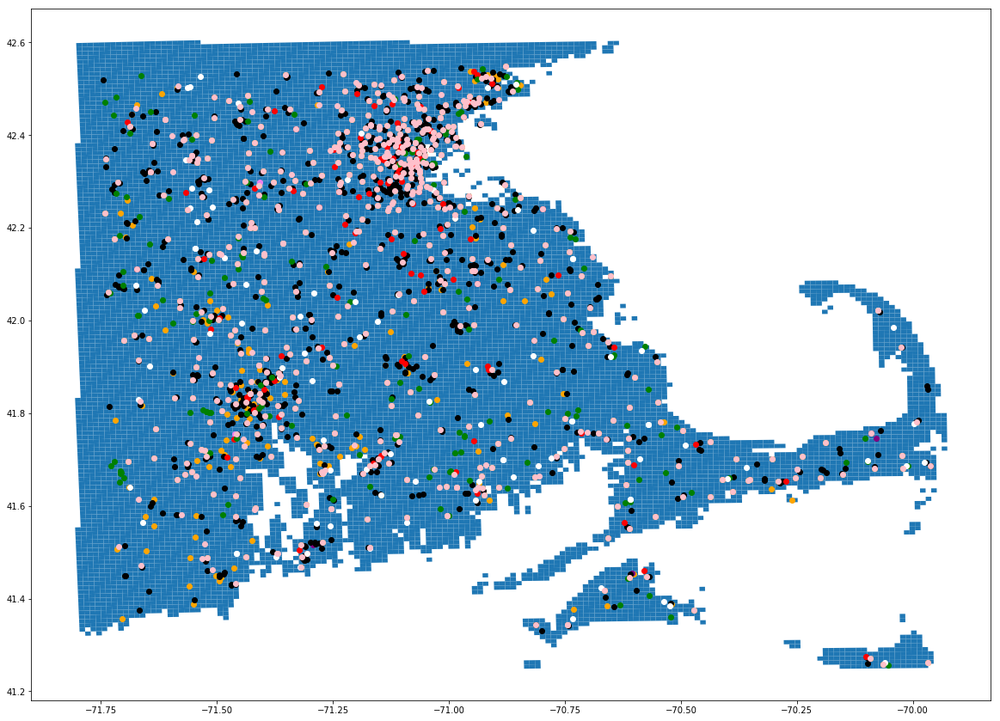

In [37]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
eff_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
eff_small_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
eff_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)
eff_plants.to_crs(game_grid.crs).plot(color='green', ax=ax, zorder=15)
eff_towers.to_crs(game_grid.crs).plot(color='white', ax=ax, zorder=15)
eff_stations.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5)
eff_lcl_eo.to_crs(game_grid.crs).plot(color='purple', ax=ax, zorder=5)
eff_stt_eo.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)
eff_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)
eff_big_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)
plt.savefig('hospitalround3.png')

All Non-Functioning Facilities

/usr/local/lib/python3.6/dist-packages/geopandas/plotting.py:418: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  "empty. Nothing has been displayed.", UserWarning)


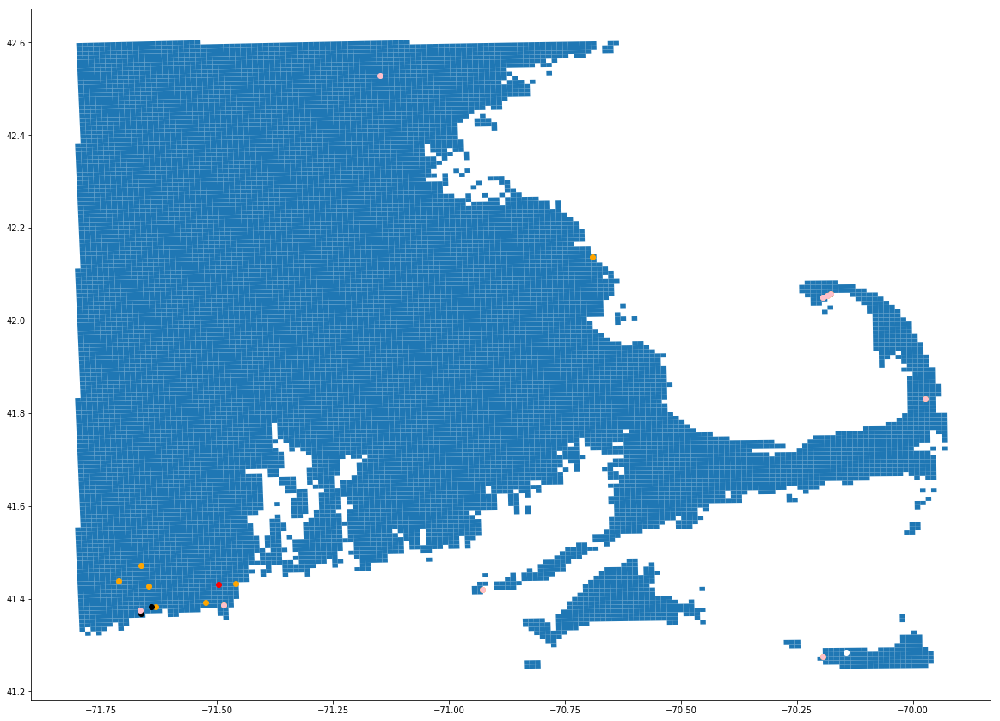

In [38]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
dead_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
dead_small_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
dead_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)
dead_plants.to_crs(game_grid.crs).plot(color='green', ax=ax, zorder=15)
dead_towers.to_crs(game_grid.crs).plot(color='white', ax=ax, zorder=15)
dead_stations.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5)
dead_lcl_eo.to_crs(game_grid.crs).plot(color='purple', ax=ax, zorder=5)
dead_stt_eo.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)
dead_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)
dead_big_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)

All Supplied Facilities

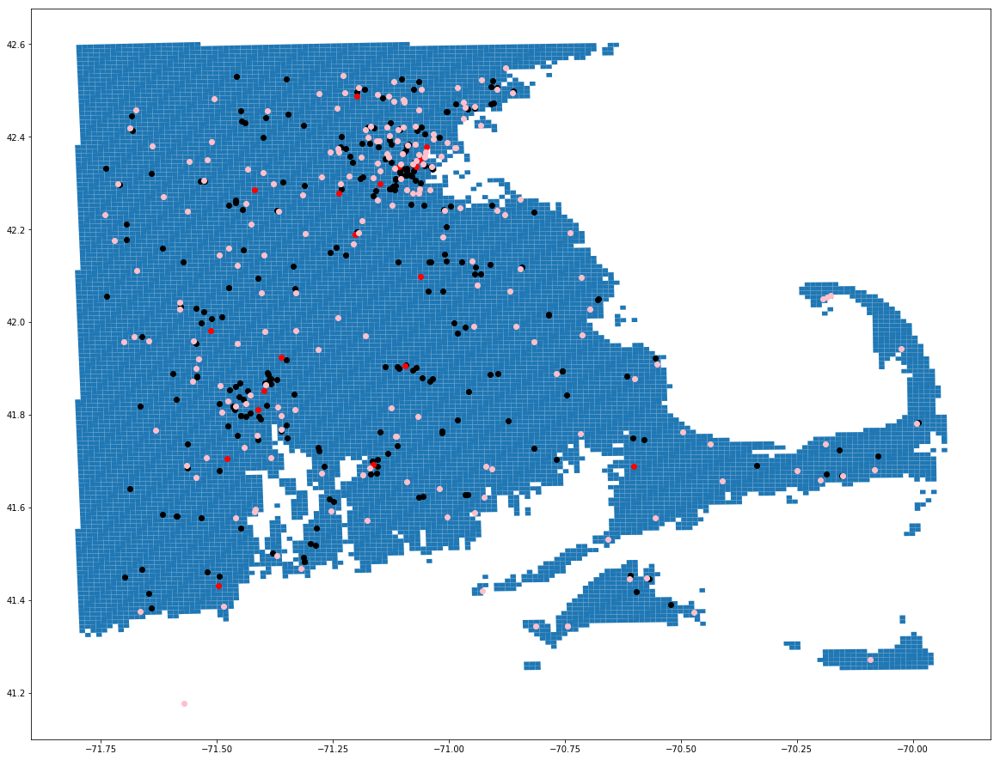

In [39]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
ws_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
ws_small_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
ws_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)
ws_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)
ws_big_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)

All Non-Supplied Facilities

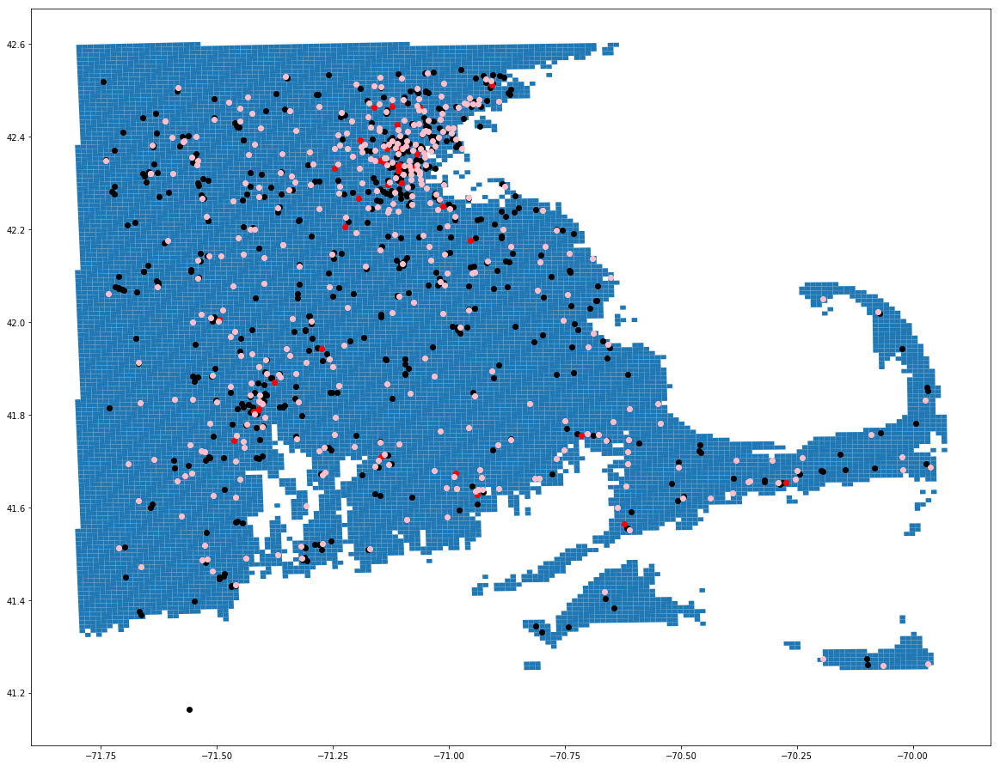

In [40]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
oos_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
oos_small_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
oos_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)
oos_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)
oos_big_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)

All Working Facilities

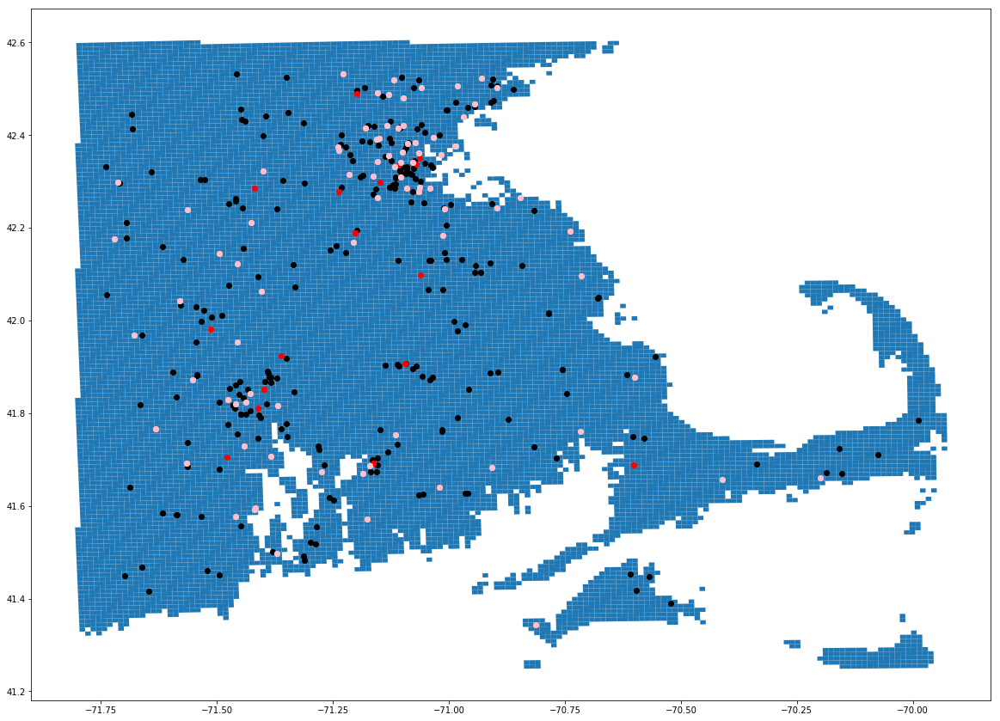

In [41]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
w_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
w_small_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
w_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)
w_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)
w_big_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)

#All Hospitals and EMS

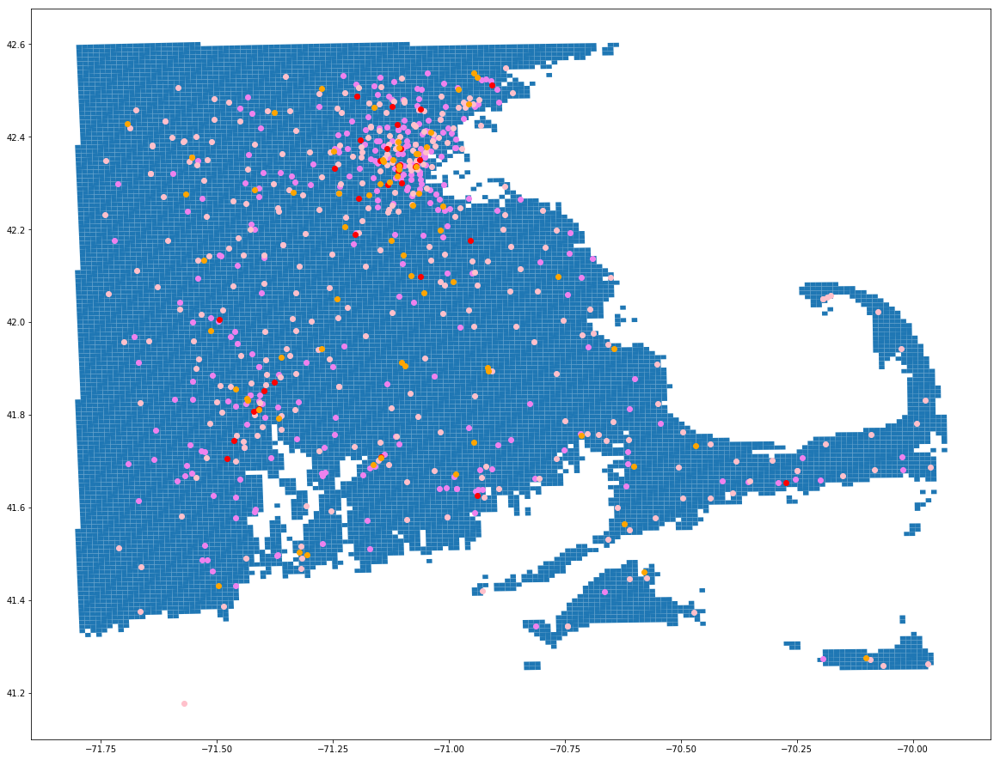

In [42]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
small_hospitals.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15)
small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10)
big_EMS.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

All Functioning Hospitals and EMS

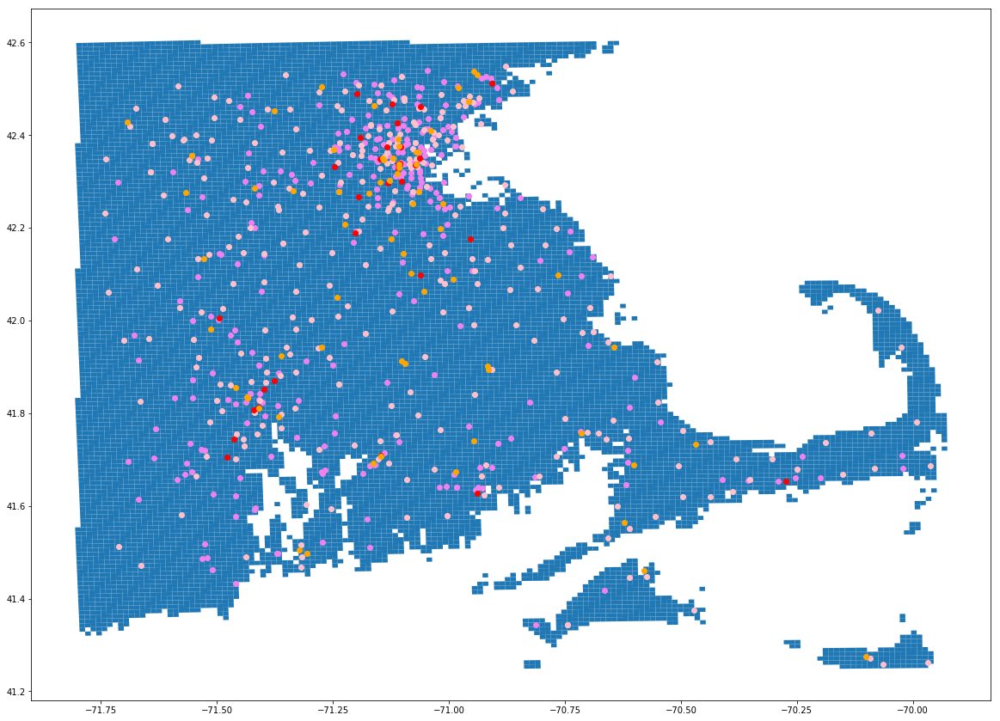

In [43]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
eff_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
eff_small_hospitals.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15)
eff_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10)
eff_big_EMS.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

All Non-Functioning Hospitals and EMS

/usr/local/lib/python3.6/dist-packages/geopandas/plotting.py:418: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  "empty. Nothing has been displayed.", UserWarning)


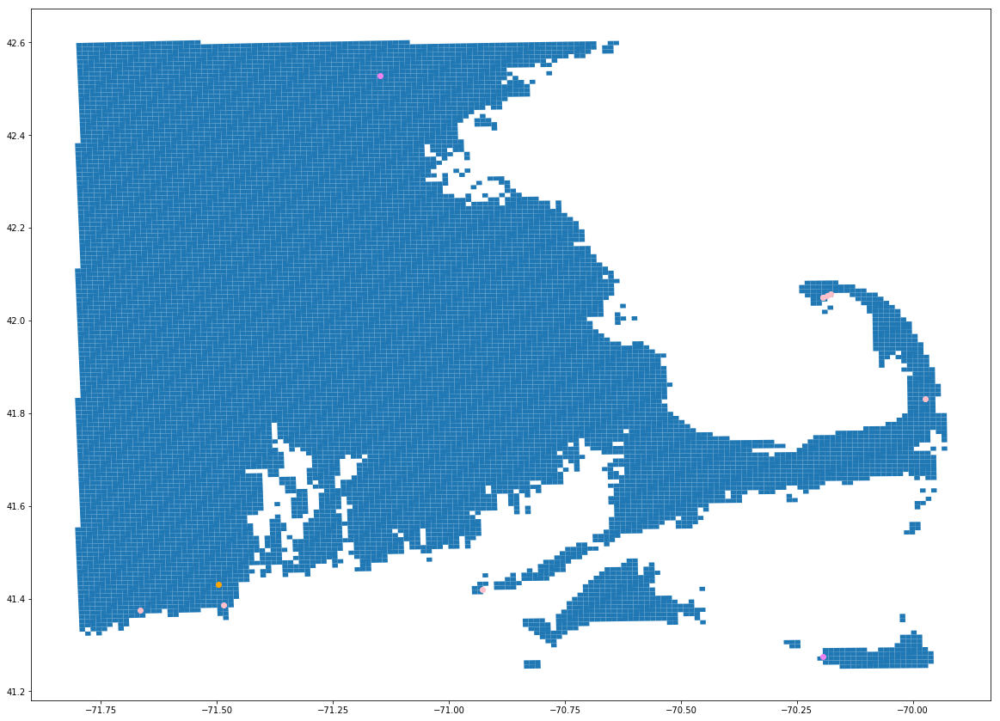

In [44]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
dead_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
dead_small_hospitals.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15)
dead_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10)
dead_big_EMS.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

All Supplied Hospitals and EMS

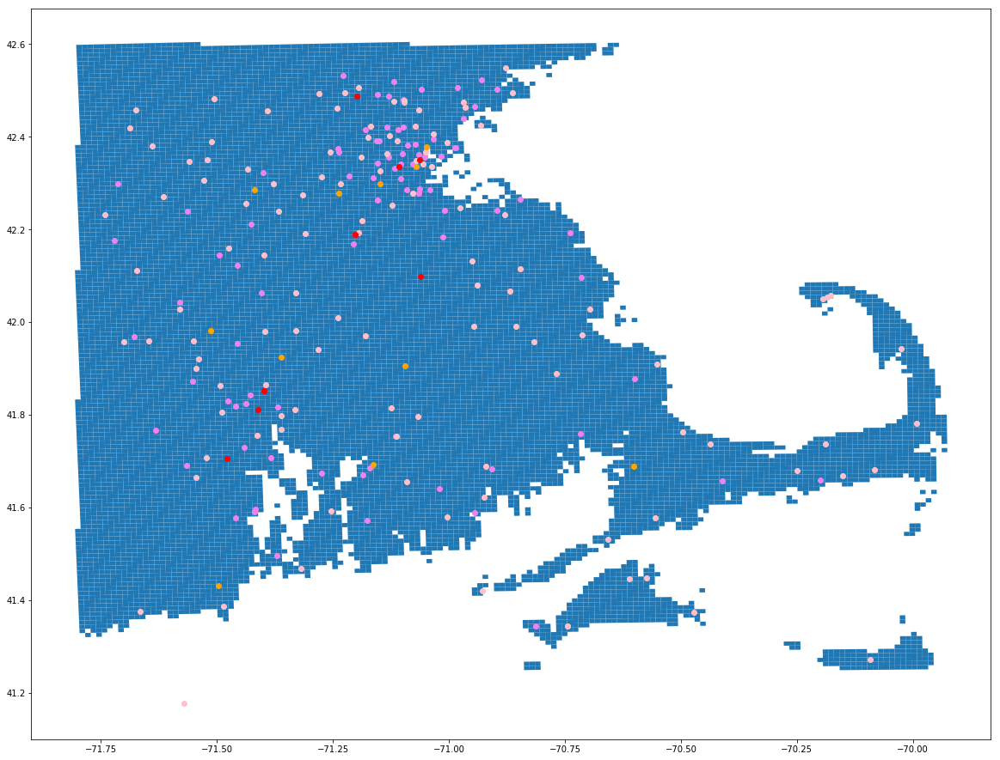

In [45]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
ws_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
ws_small_hospitals.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15)
ws_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10)
ws_big_EMS.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

Non-Supplied Hospitals and EMS

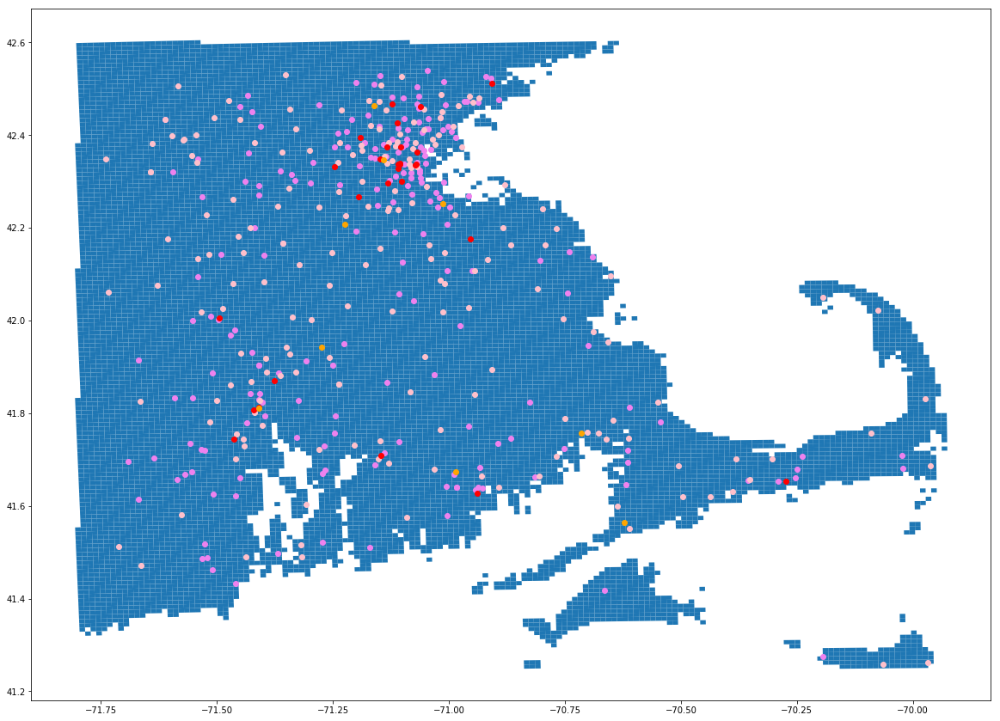

In [46]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
oos_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
oos_small_hospitals.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15)
oos_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10)
oos_big_EMS.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

Working Hospitals and EMS

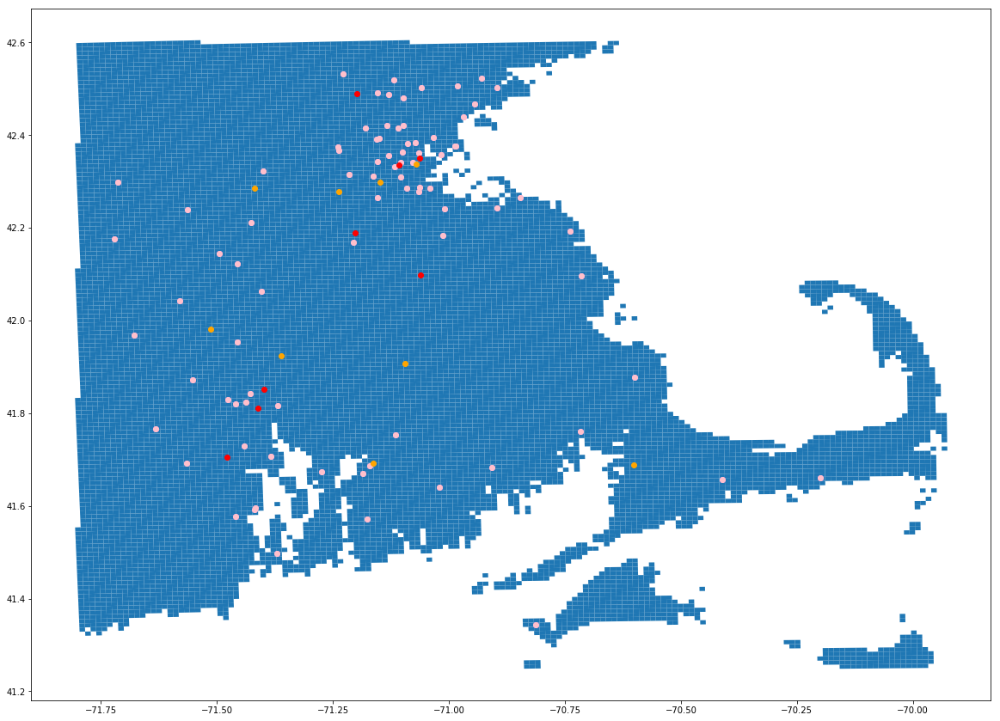

In [47]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
w_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
w_small_hospitals.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15)
w_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10)
w_big_EMS.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

#Graph of Working and Closed Hospitals

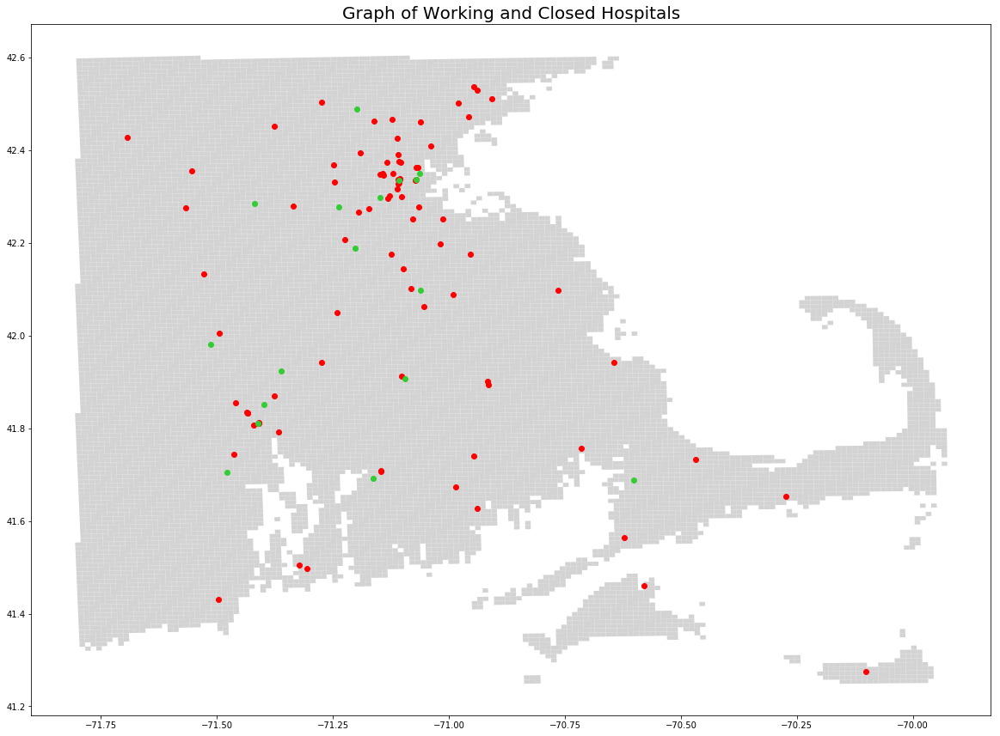

In [103]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, color='lightgrey')
ax.set_title('Graph of Working and Closed Hospitals' , fontsize=20)
w_big_hospitals.to_crs(game_grid.crs).plot(color='limegreen', ax=ax, zorder=15)
w_small_hospitals.to_crs(game_grid.crs).plot(color='limegreen', ax=ax, zorder=15)
nw_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=10)
nw_small_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=10)

Hospital and EMS Coverage

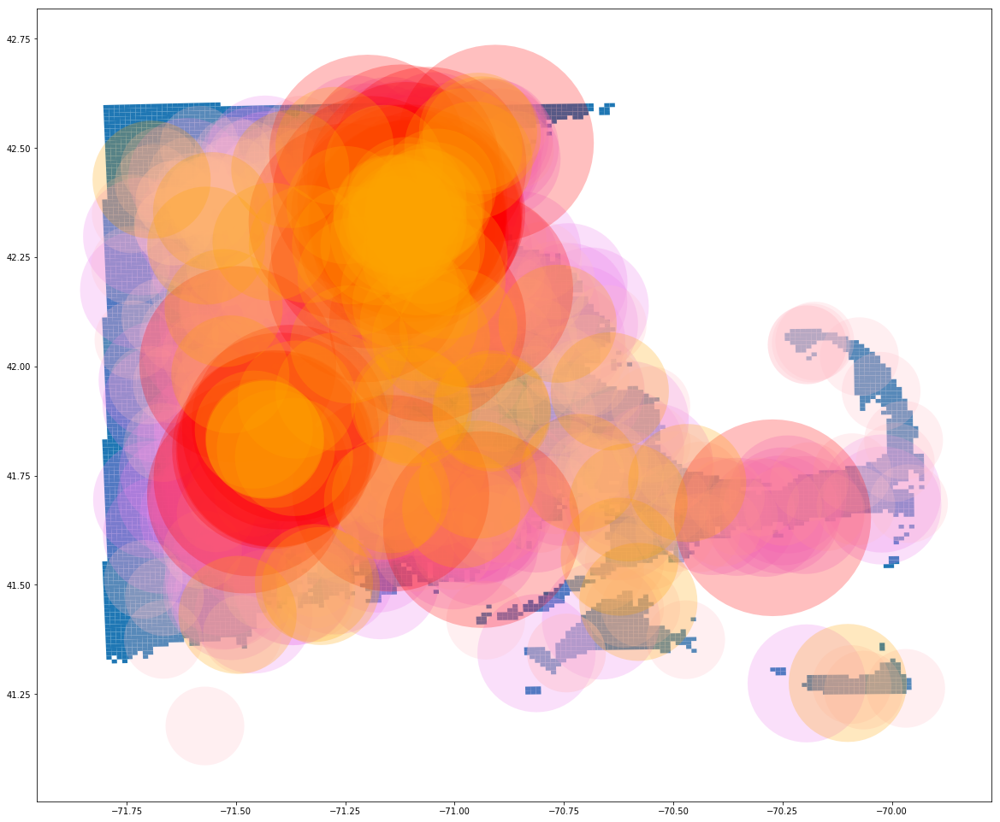

In [49]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
big_hospitals.buffer(0.22522522522).to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15, alpha=0.25)
small_hospitals.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15, alpha=0.25)
small_EMS.buffer(0.09009009009).to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10, alpha=0.25)
big_EMS.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5, alpha=0.25)

Functional Hospital and EMS Coverage

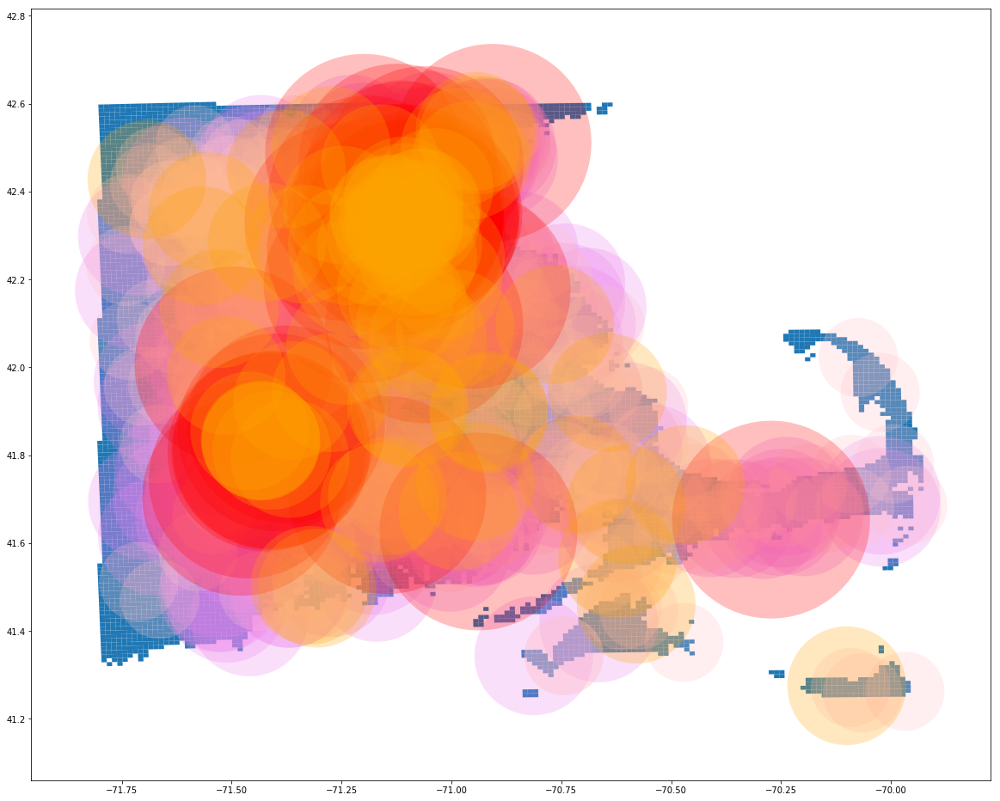

In [50]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
eff_big_hospitals.buffer(0.22522522522).to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15, alpha=0.25)
eff_small_hospitals.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15, alpha=0.25)
eff_small_EMS.buffer(0.09009009009).to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10, alpha=0.25)
eff_big_EMS.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5, alpha=0.25)

Supplied Hospital and EMS Coverage

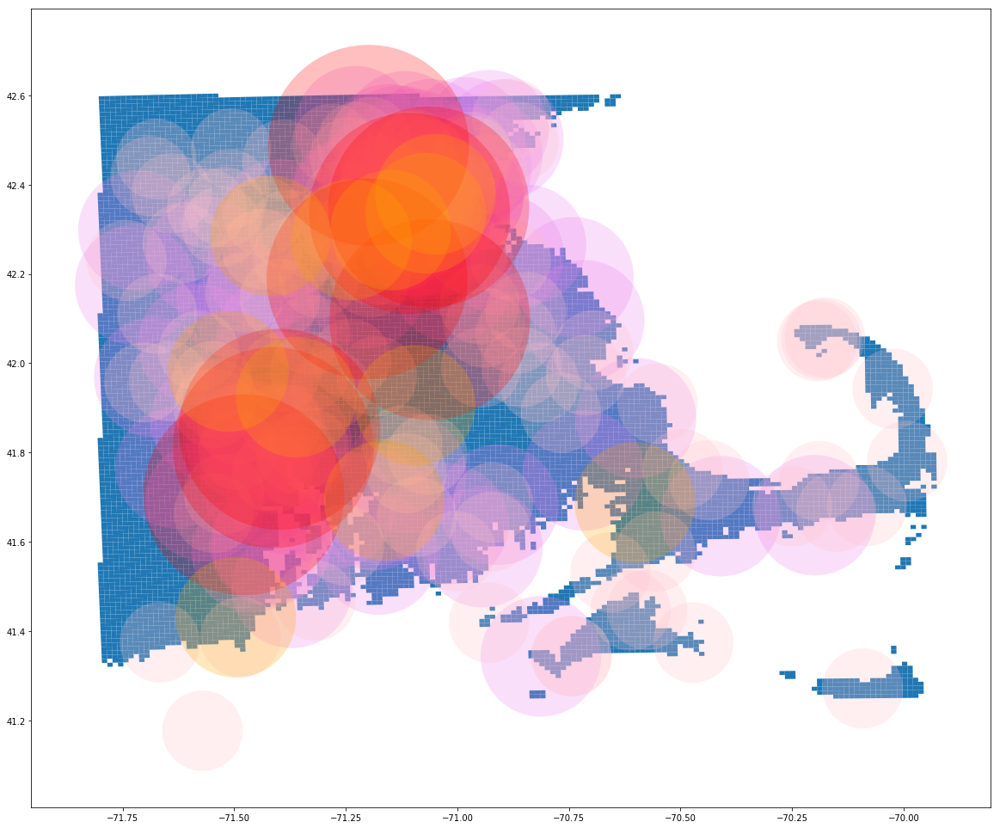

In [51]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
ws_big_hospitals.buffer(0.22522522522).to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15, alpha=0.25)
ws_small_hospitals.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15, alpha=0.25)
ws_small_EMS.buffer(0.09009009009).to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10, alpha=0.25)
ws_big_EMS.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5, alpha=0.25)

Working Hospital and EMS Coverage

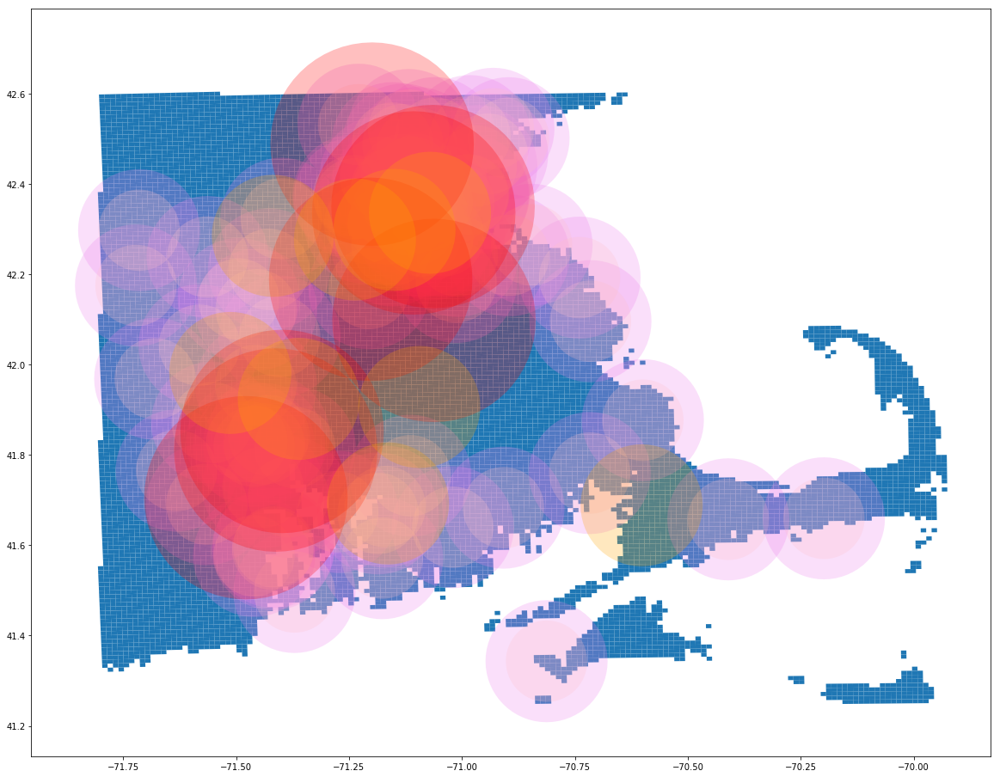

In [52]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
w_big_hospitals.buffer(0.22522522522).to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15, alpha=0.25)
w_small_hospitals.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15, alpha=0.25)
w_small_EMS.buffer(0.09009009009).to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10, alpha=0.25)
w_big_EMS.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5, alpha=0.25)

#Shelters

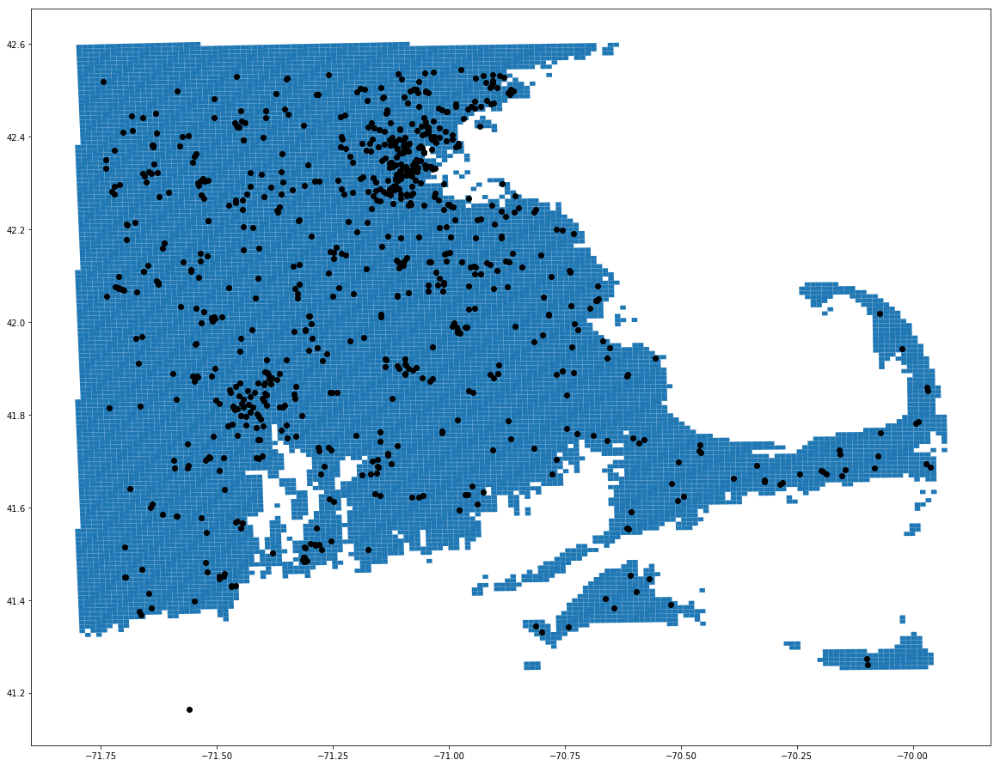

In [53]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)

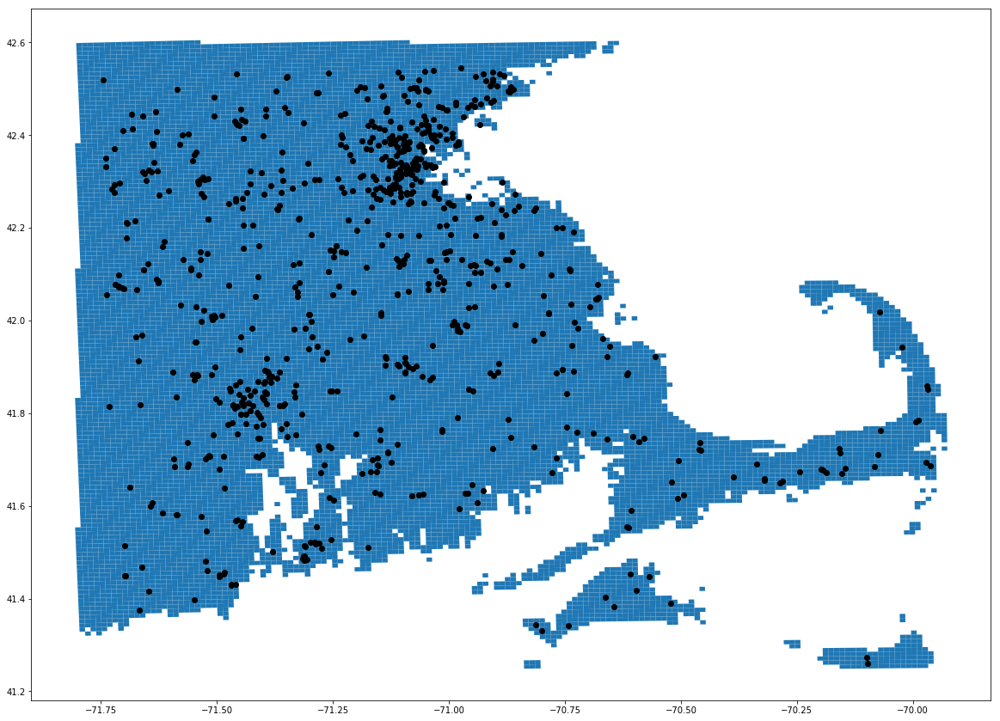

In [54]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
eff_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)

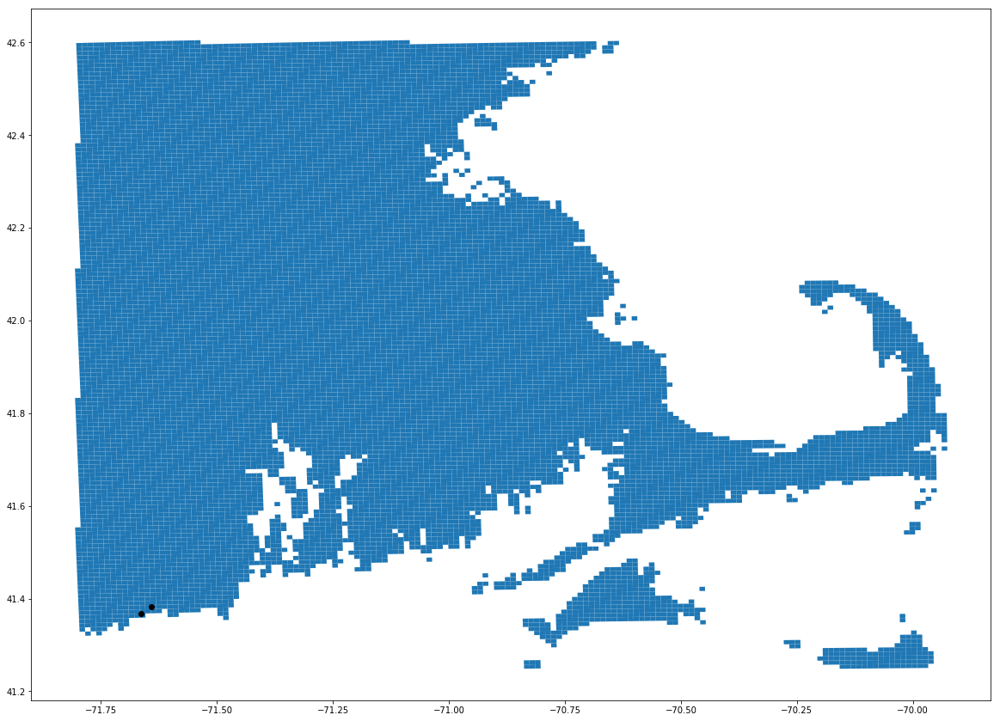

In [55]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
dead_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)

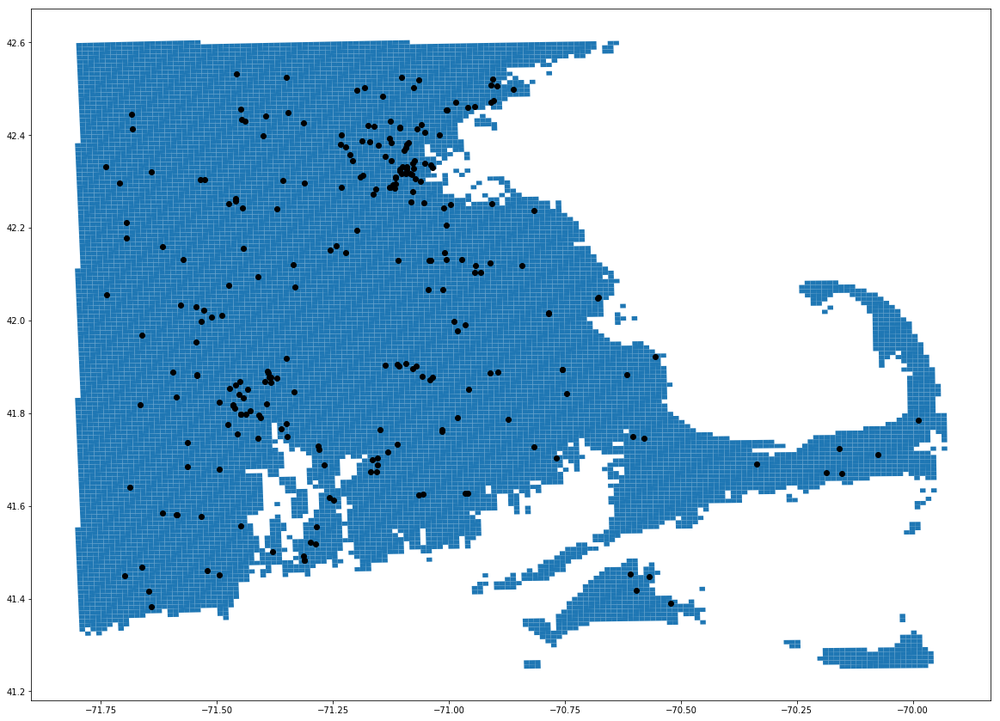

In [56]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
ws_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)

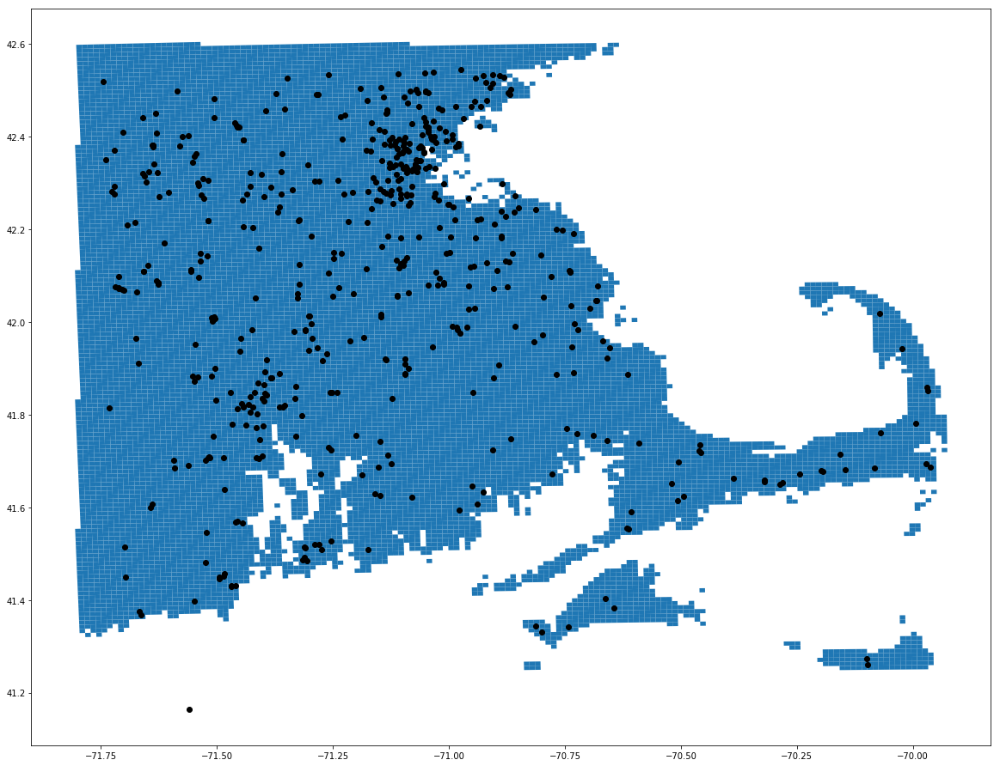

In [57]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
oos_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)

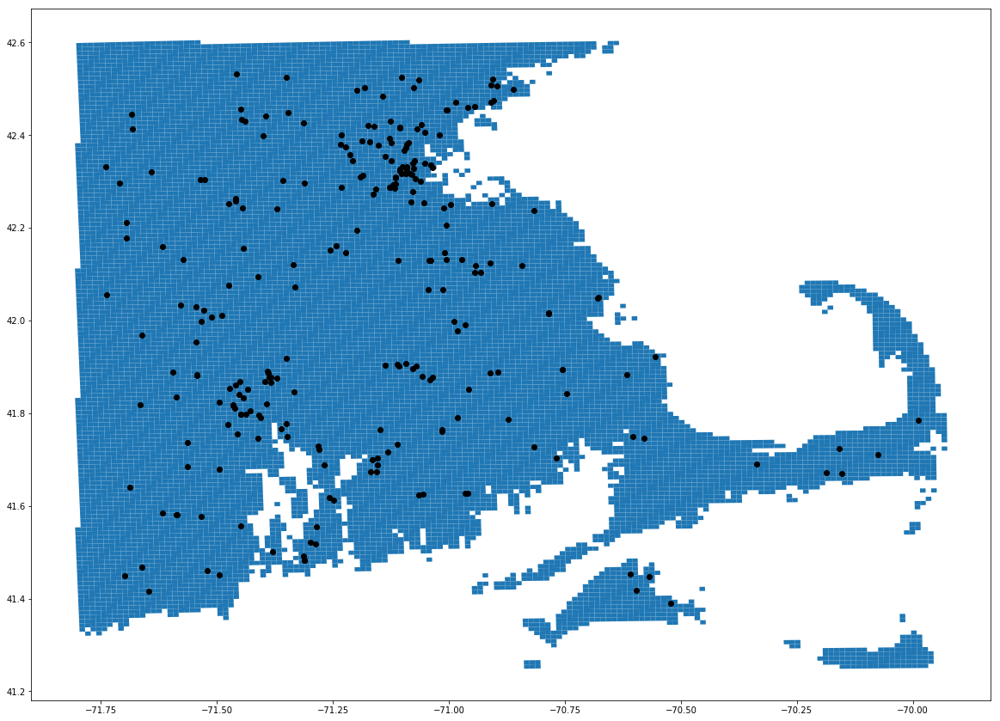

In [58]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
w_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)

#Graph of Working and Closed Shelters

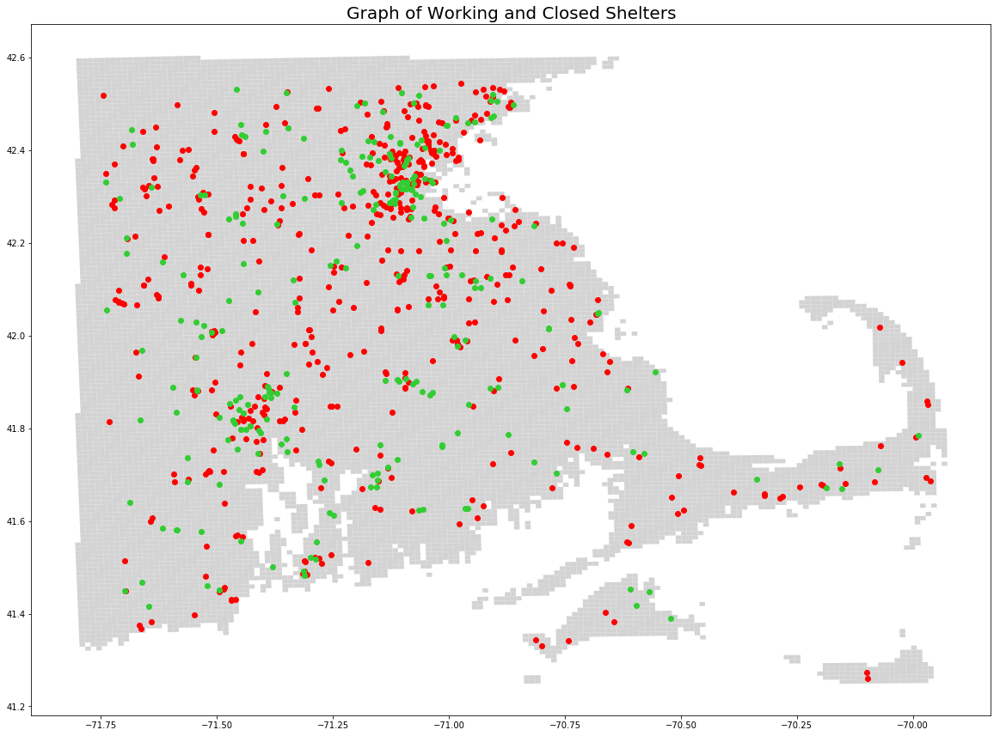

In [59]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, color='lightgrey')
ax.set_title('Graph of Working and Closed Shelters', fontsize=20)
w_shelters.to_crs(game_grid.crs).plot(color='limegreen', ax=ax, zorder=15)
nw_shelters.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=10)

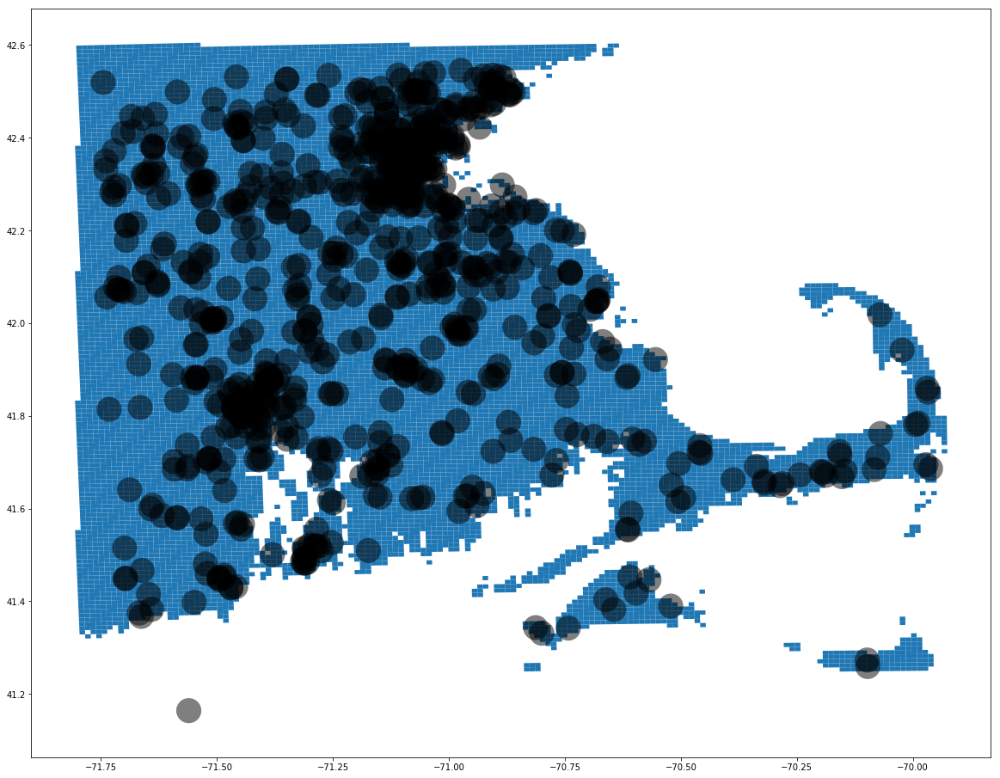

In [60]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
shelters.buffer(0.02702702702).to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10, alpha=.5)

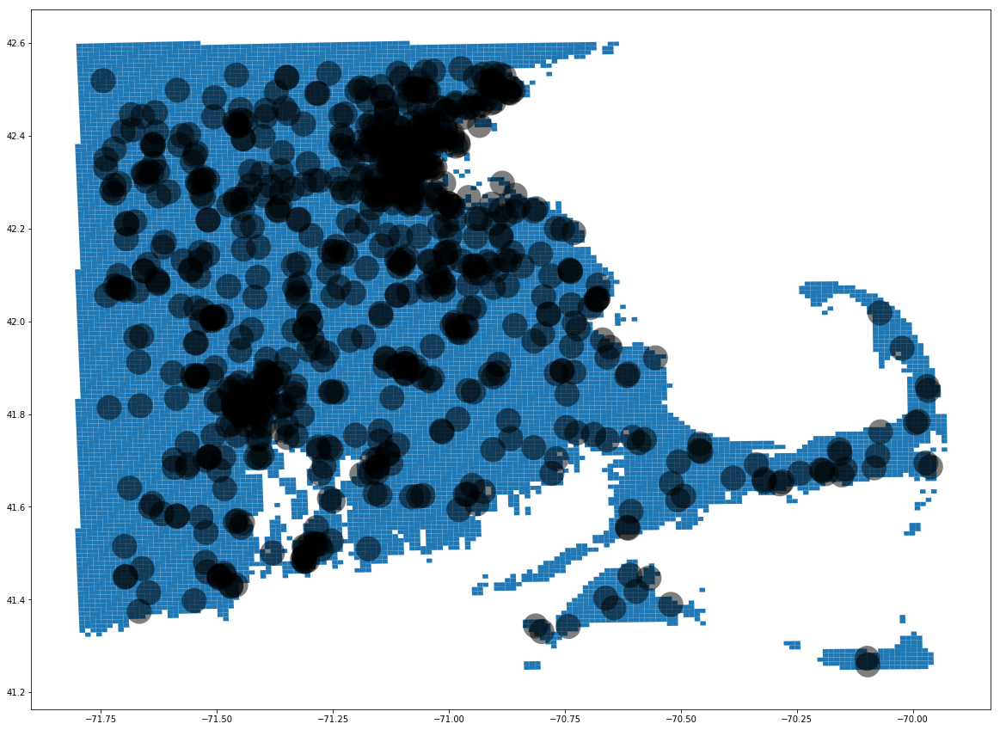

In [61]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
eff_shelters.buffer(0.02702702702).to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10, alpha=.5)

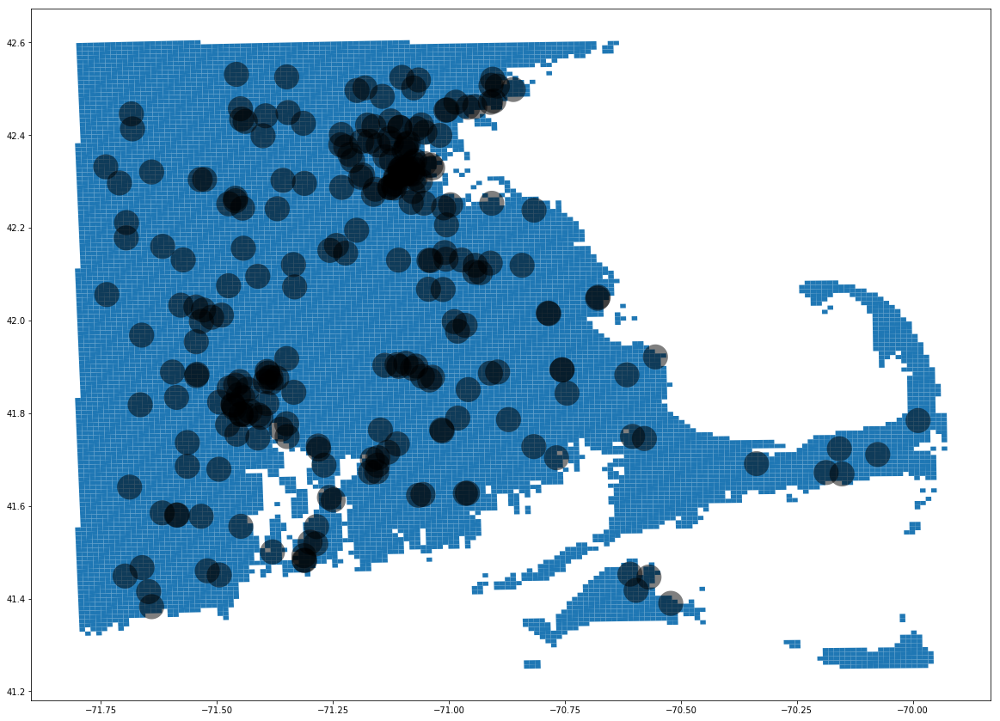

In [62]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
ws_shelters.buffer(0.02702702702).to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10, alpha=.5)

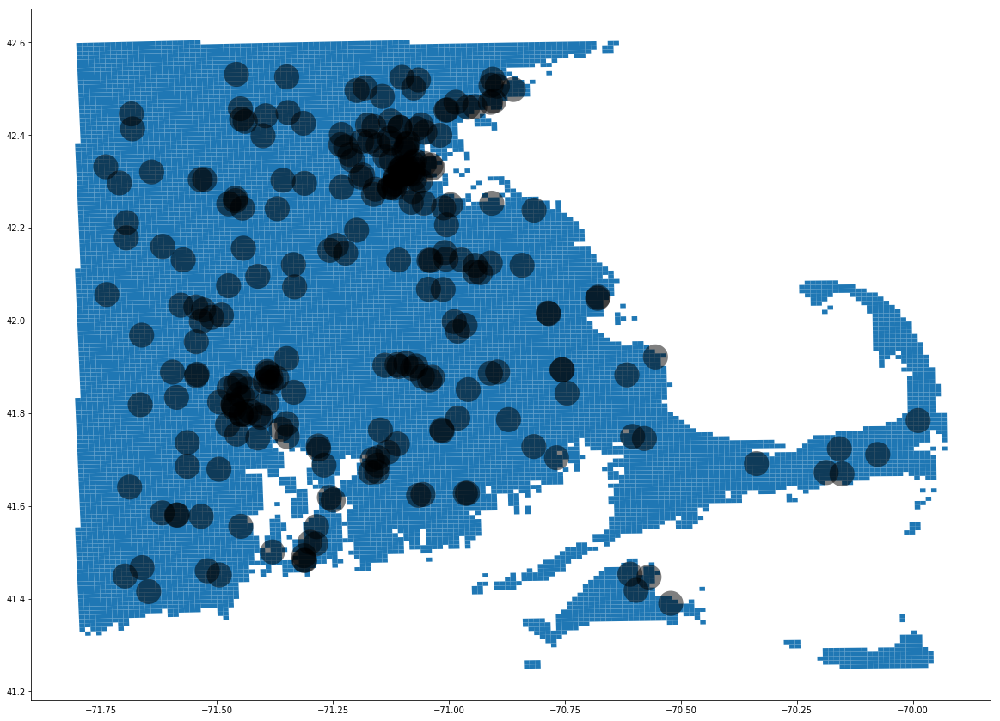

In [63]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
w_shelters.buffer(0.02702702702).to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10, alpha=.5)

#Power Plants and Cell Towers

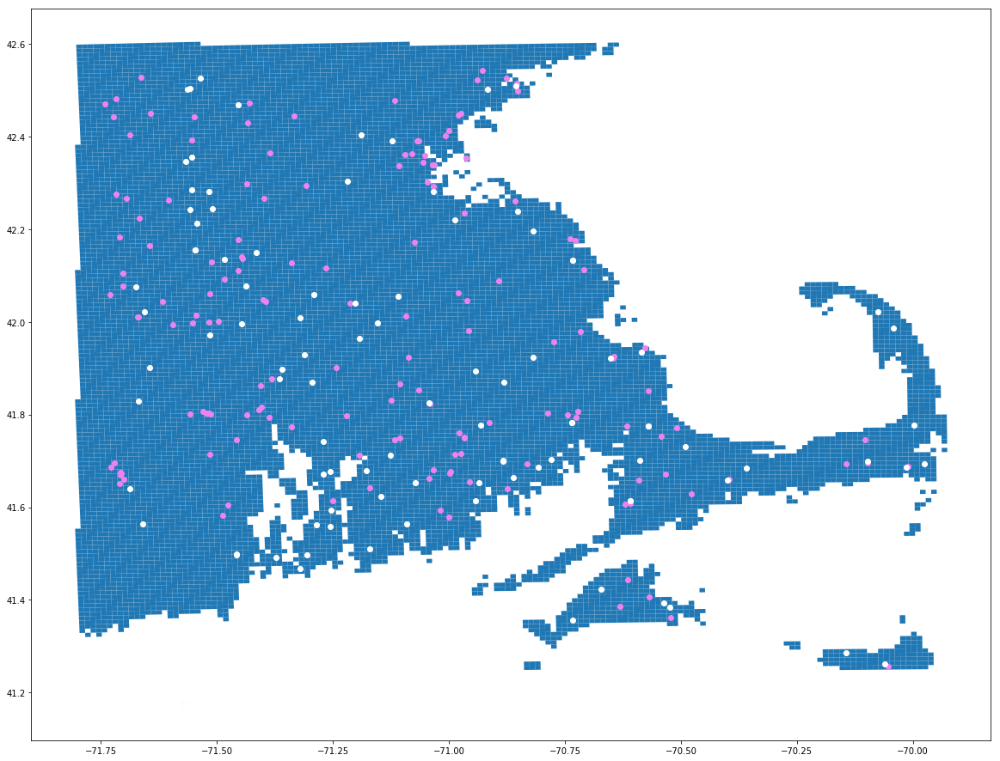

In [64]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
plants.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=15)
towers.to_crs(game_grid.crs).plot(color='white', ax=ax, zorder=15)

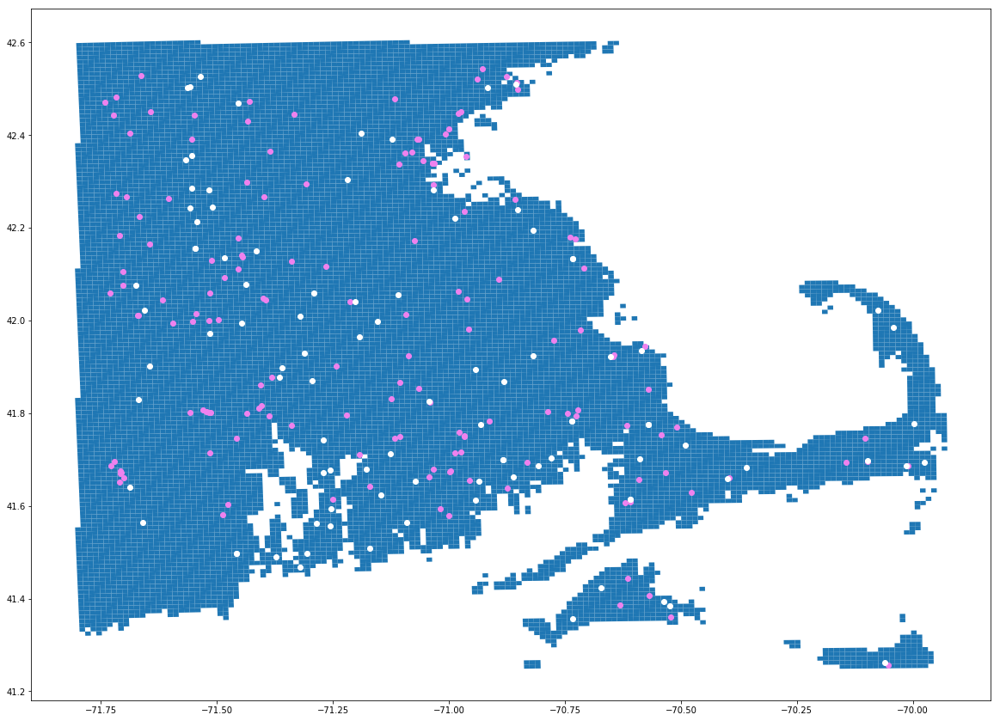

In [65]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
eff_plants.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=15)
eff_towers.to_crs(game_grid.crs).plot(color='white', ax=ax, zorder=15)

/usr/local/lib/python3.6/dist-packages/geopandas/plotting.py:418: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  "empty. Nothing has been displayed.", UserWarning)


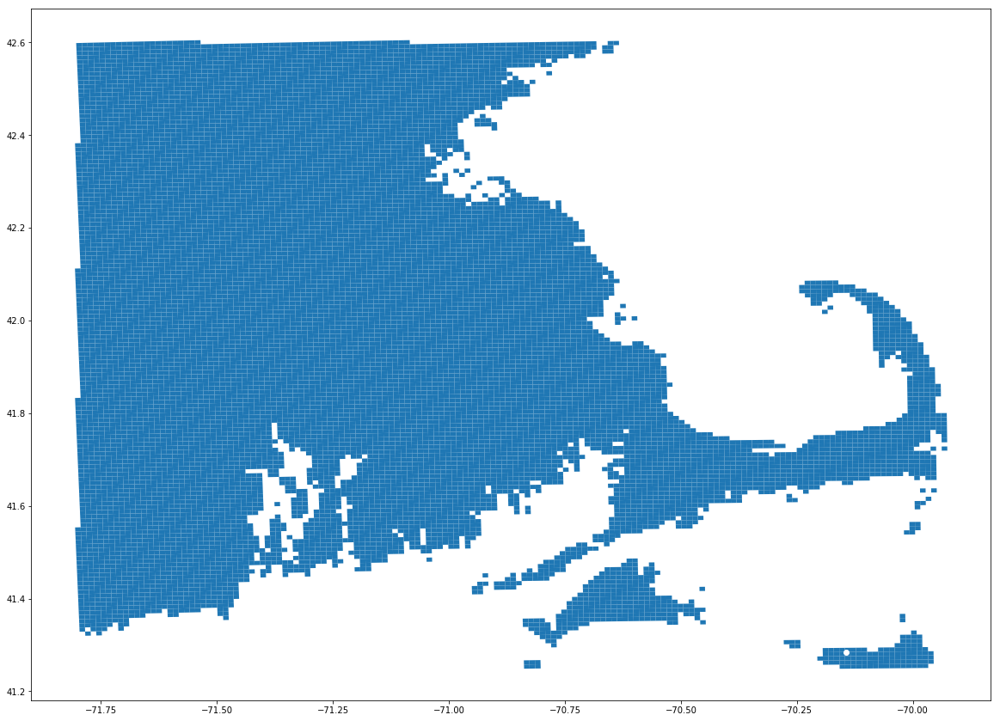

In [66]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
dead_plants.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=15)
dead_towers.to_crs(game_grid.crs).plot(color='white', ax=ax, zorder=15)

Power Plant Coverage

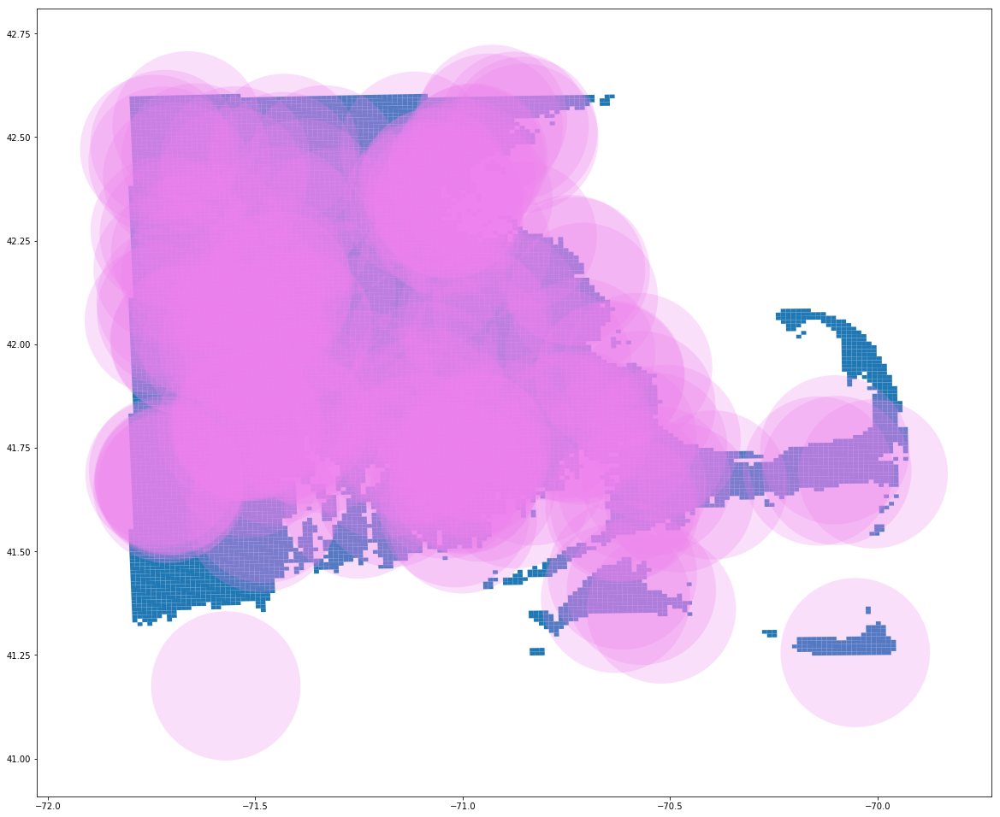

In [67]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
plants.buffer(0.18018018018).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=20, alpha=0.25)

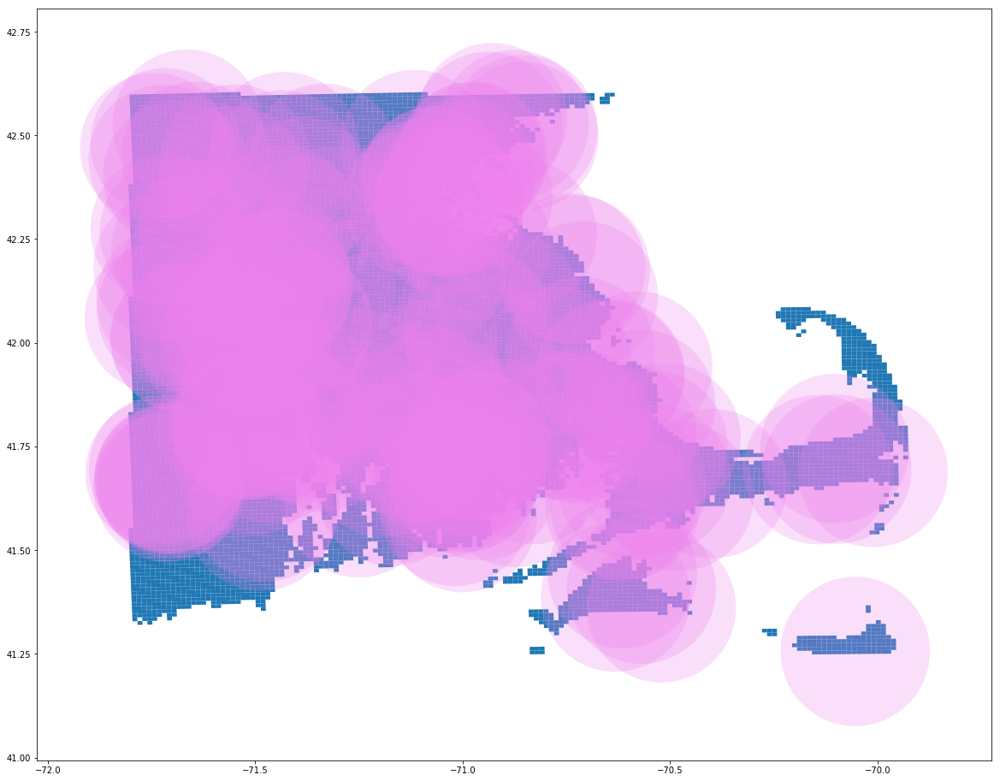

In [68]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
eff_plants.buffer(0.18018018018).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=20, alpha=0.25)

Cell Tower Coverage

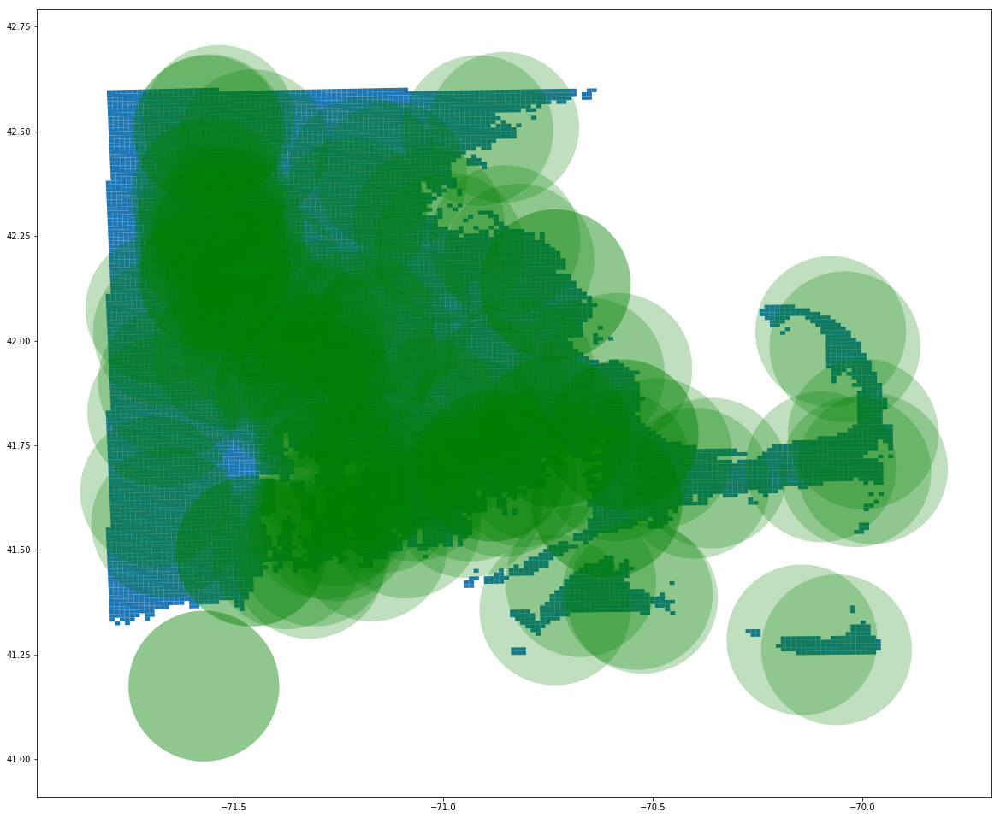

In [69]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
towers.buffer(0.18018018018).to_crs(game_grid.crs).plot(color='green', ax=ax, zorder=15, alpha=0.25)

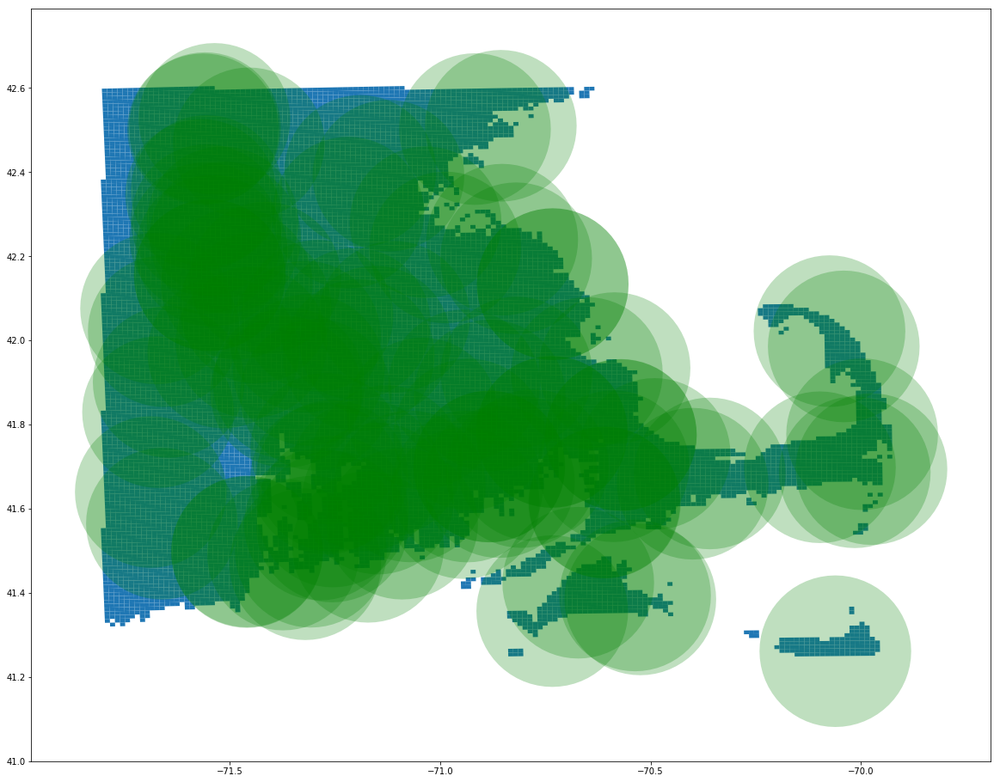

In [70]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
eff_towers.buffer(0.18018018018).to_crs(game_grid.crs).plot(color='green', ax=ax, zorder=15, alpha=0.25)

#Fire Stations

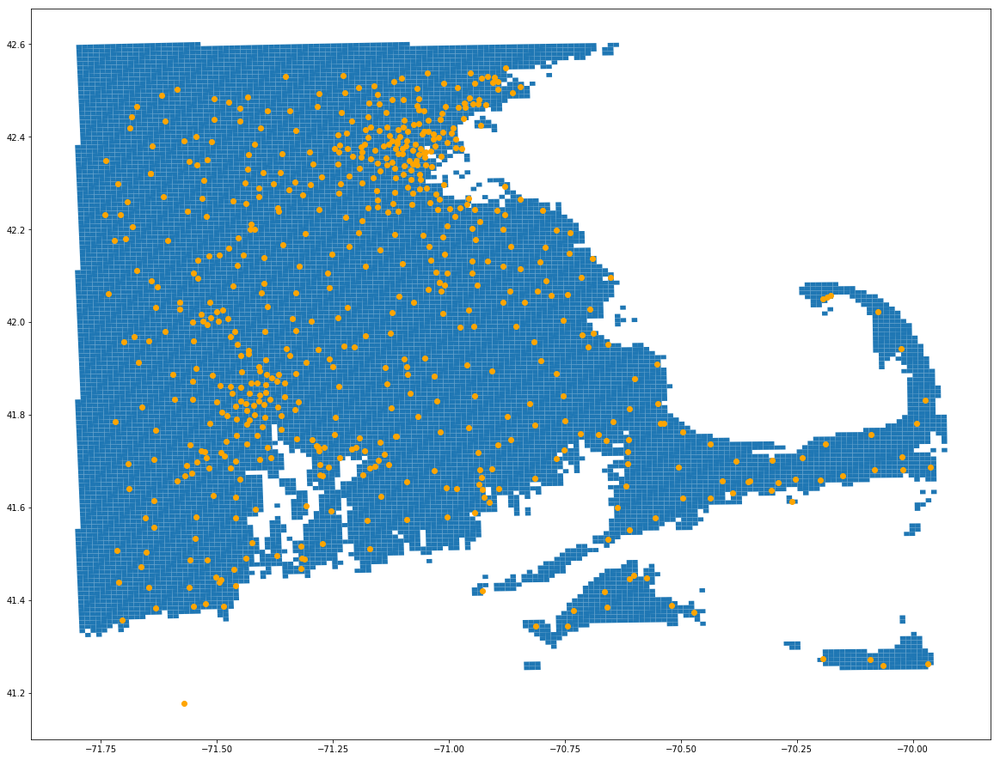

In [71]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
stations.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5)

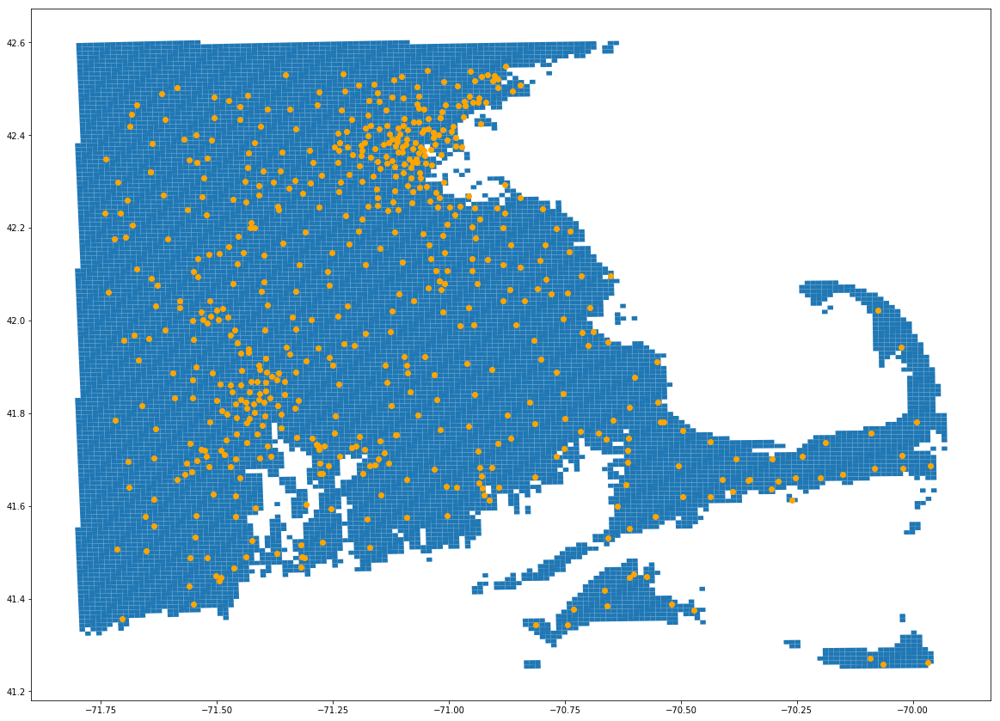

In [72]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
eff_stations.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5)

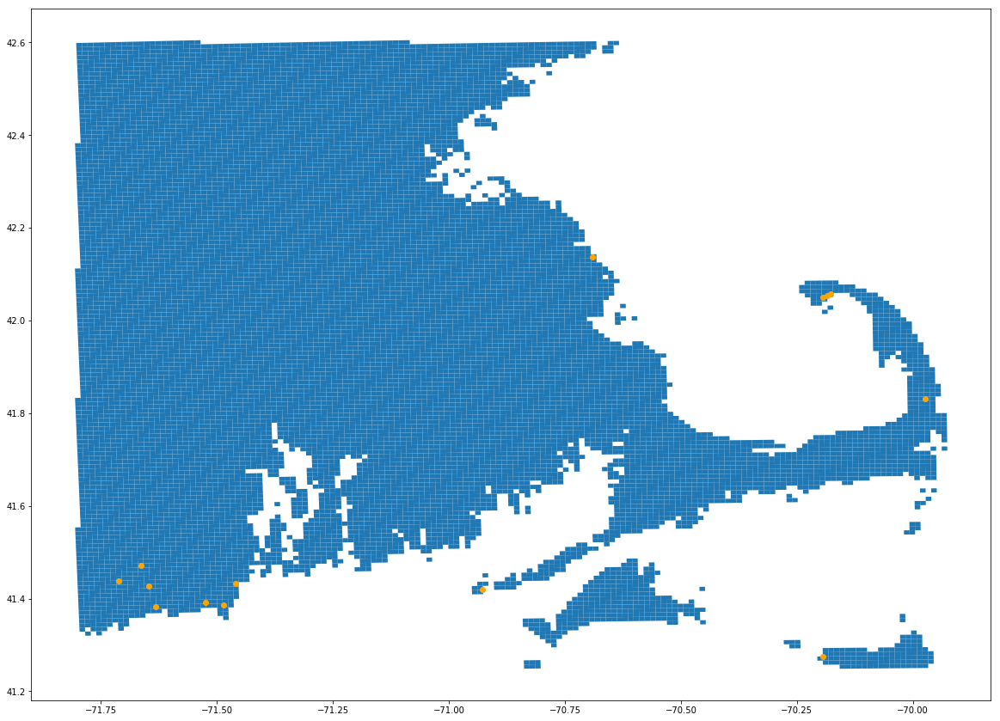

In [73]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
dead_stations.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5)

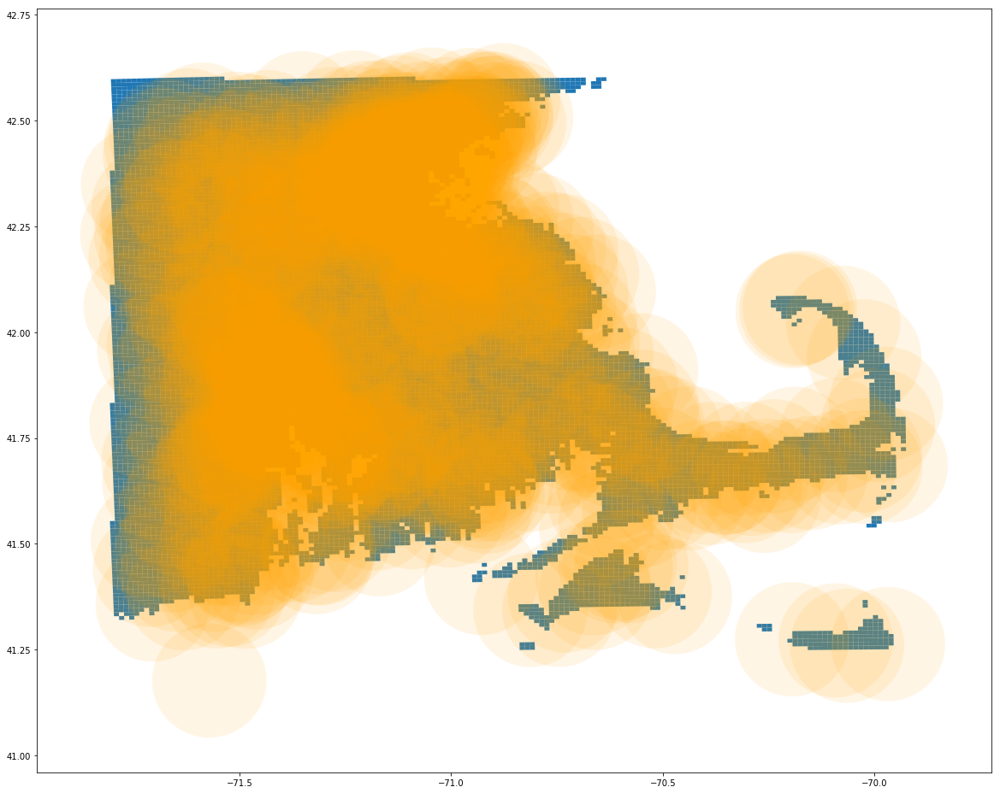

In [74]:
#transportation
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
stations.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5, alpha=0.1)

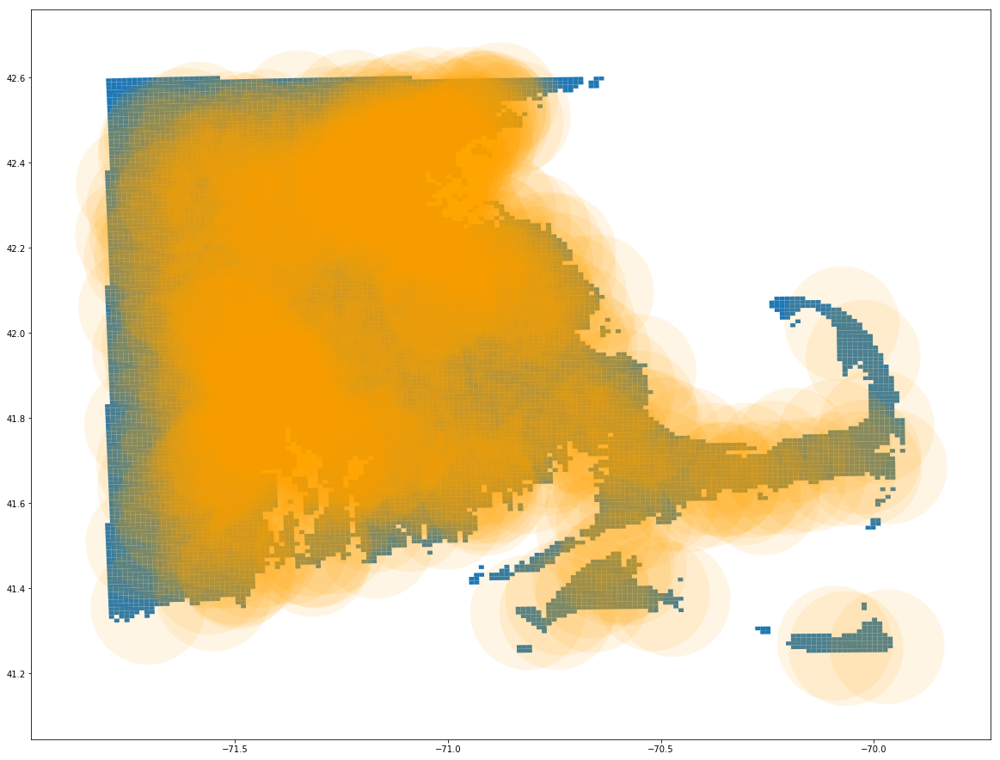

In [75]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
eff_stations.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5, alpha=0.1)

#Emergency Operations

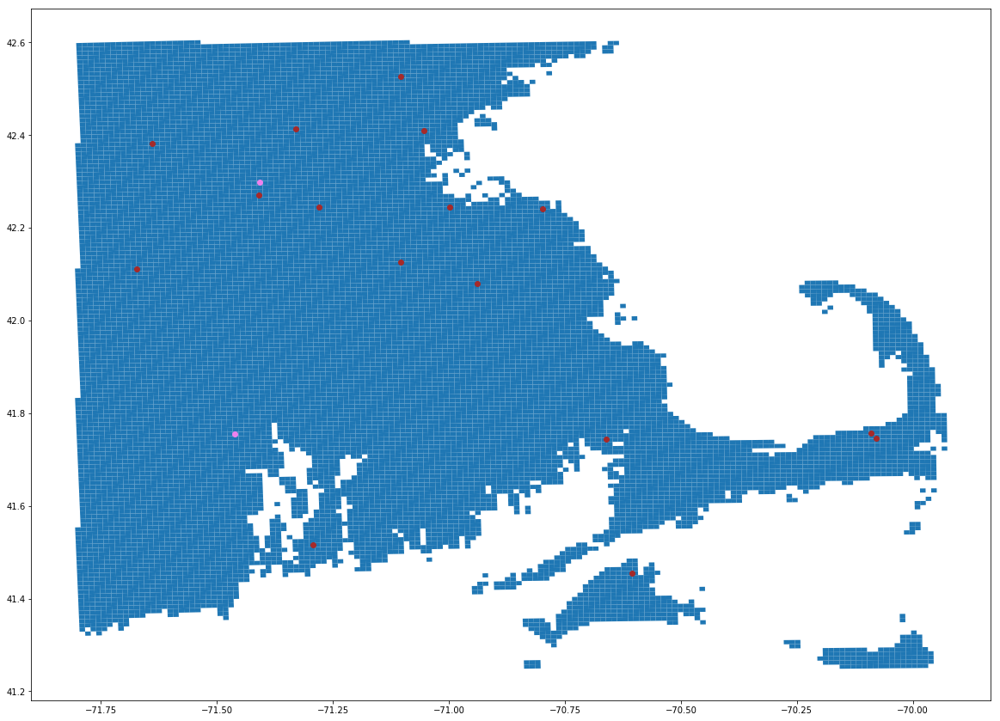

In [76]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
local_eo.to_crs(game_grid.crs).plot(color='brown', ax=ax, zorder=5)
state_eo.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

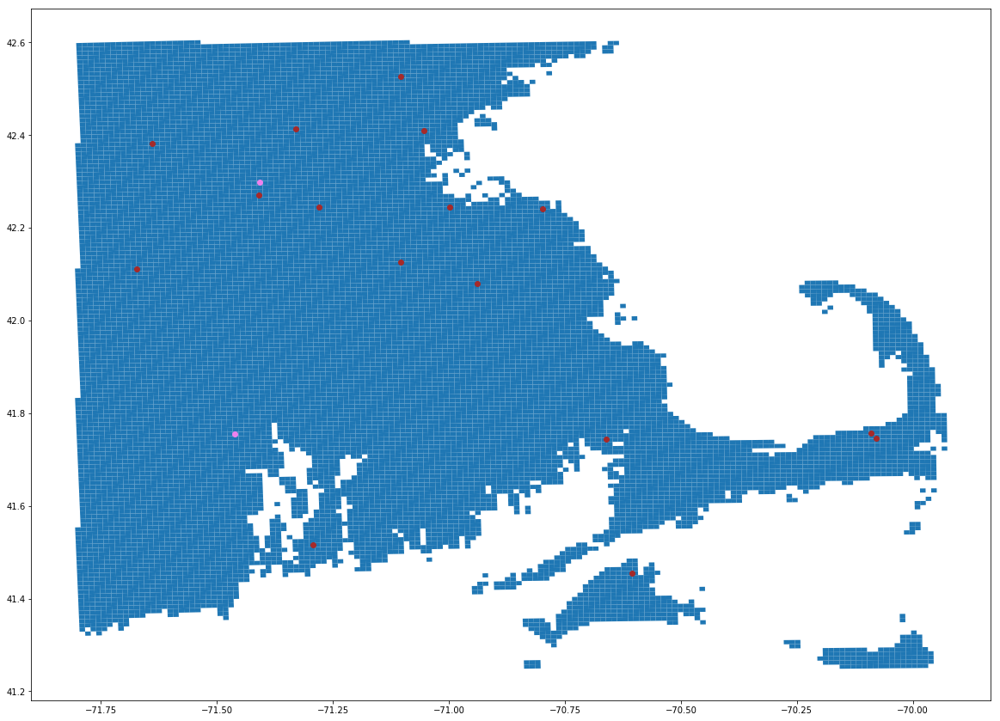

In [77]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
eff_lcl_eo.to_crs(game_grid.crs).plot(color='brown', ax=ax, zorder=5)
eff_stt_eo.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

/usr/local/lib/python3.6/dist-packages/geopandas/plotting.py:418: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  "empty. Nothing has been displayed.", UserWarning)


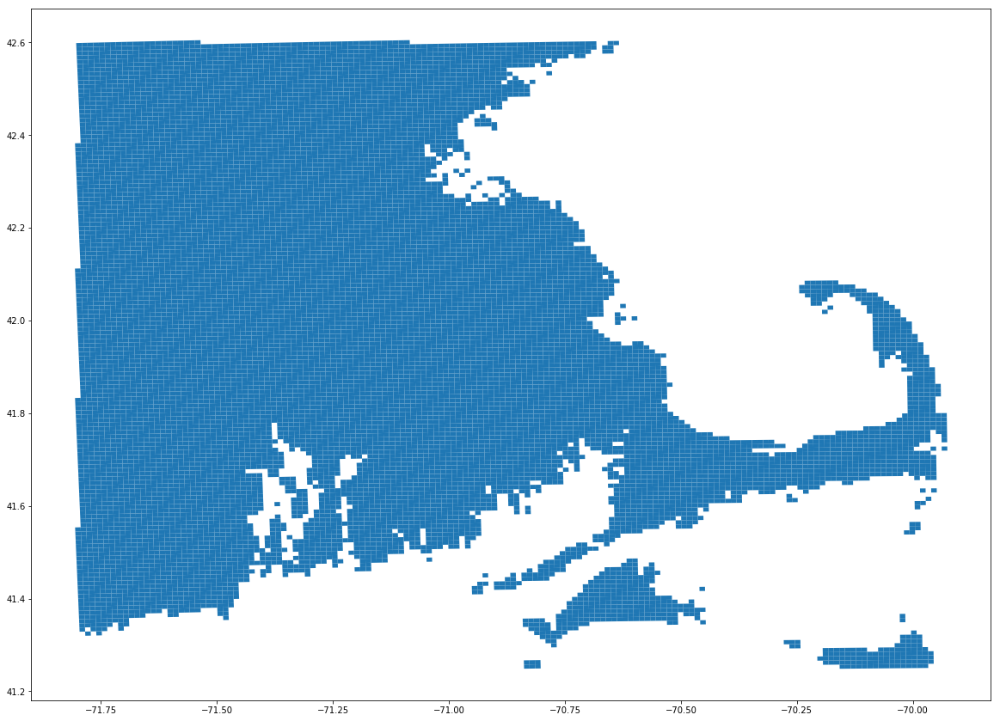

In [78]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
dead_lcl_eo.to_crs(game_grid.crs).plot(color='brown', ax=ax, zorder=5)
dead_stt_eo.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

In [90]:
nw_shelters

,ID,NAME,ADDRESS,CITY,STATE,ZIP,geometry,objectid,type,facility,health_bon,utilities_,transport_,radius,health_inf,util_info,transpor_1,util_req,daily_food,daily_medi,daily_fuel,food_water,medicine,fuel,index_right,Health,Utility,Transporta
0,440053,CHARIHO HIGH SCHOOL,453 SWITCH RD,WOOD RIVER JUNCTION,RI,02894,POINT Z (-71.69645016953967 41.45008495985309 0),440053,shelter,shelter,1,0,0,3000,0,0,0,3,100,0,0,0.0,0.0,0.0,11240,10,8,10
1,250058,PLYMOUTH MEMORIAL HALL,83 COURT ST,PLYMOUTH,MA,02360,POINT Z (-70.66868707654731 41.95993545265907 0),250058,shelter,shelter,1,0,0,3000,0,0,0,3,100,0,0,0.0,0.0,0.0,6034,10,10,10
3,440143,POLICE COMMUNITY ROOM,4901 OLD POST ROAD,CHARLESTOWN,RI,02813,POINT Z (-71.66756608580619 41.3747401230583 0),440143,shelter,shelter,1,0,0,3000,0,0,0,3,100,0,0,0.0,0.0,0.0,11665,10,7,10
4,251067,BEDFORD HIGH SCHOOL,9 MUDGE WAY,BEDFORD,MA,01730,POINT Z (-71.28553538015365 42.49140164007366 0),251067,shelter,shelter,1,0,0,3000,0,0,0,3,100,0,0,0.0,0.0,0.0,1050,10,10,10
448,250941,BEDFORD CENTER SHELTER,12 MUDGE WAY,BEDFORD,MA,01730,POINT Z (-71.28204396285855 42.4910480599201 0),250941,shelter,shelter,1,0,0,3000,0,0,0,3,100,0,0,0.0,0.0,0.0,1050,10,10,10
6,250030,ST LUKE'S EPISCOPAL CHURCH,201 WASHINGTON AVE,CHELSEA,MA,02150,POINT Z (-71.03170313828917 42.39940325745442 0),250030,shelter,shelter,1,0,0,3000,0,0,0,3,100,0,0,0.0,0.0,0.0,1805,10,10,10
520,250405,CHELSEA HIGH SCHOOL,299 EVERETT AVE,CHELSEA,MA,02150,POINT Z (-71.03995146019167 42.40008482935144 0),250405,shelter,shelter,1,0,0,3000,0,0,0,3,100,0,0,0.0,0.0,0.0,1805,10,10,10
9,250080,ROCHESTER MEMORIAL ELEMENTARY SCHOOL,16 PINE ST,ROCHESTER,MA,02770,POINT Z (-70.86672006008268 41.74713880001565 0),250080,shelter,shelter,1,0,0,3000,0,0,0,3,100,0,0,0.0,0.0,0.0,8430,10,10,10
11,250439,HOSMER ELEMENTRY SCHOOL,1 CONCORD ROAD,WATERTOWN,MA,02472,POINT Z (-71.16842640975096 42.36869875974003 0),250439,shelter,shelter,1,0,0,3000,0,0,0,3,100,0,0,0.0,0.0,0.0,2067,10,10,10
13,250088,HYDE PARK COMMUNITY CENTER,1179 RIVER ST,HYDE PARK,MA,02136,POINT Z (-71.12102635078543 42.25551172738437 0),250088,shelter,shelter,1,0,0,3000,0,0,0,3,100,0,0,0.0,0.0,0.0,2871,10,10,10


In [92]:
nw_small_hospitals

,OBJECTID,ID,NAME,ADDRESS,CITY,STATE,ZIP,TYPE,STATUS,COUNTY,COUNTYFIPS,COUNTRY,LATITUDE,LONGITUDE,NAICS_CODE,NAICS_DESC,WEBSITE,OWNER,TTL_STAFF,BEDS,HELIPAD,geometry,objectid,type,facility,health_bon,utilities_,transport_,radius,health_inf,util_info,transpor_1,util_req,daily_food,daily_medi,daily_fuel,food_water,medicine,fuel,index_right,Health,Utility,Transporta
0,18.0,0006002401,VA MEDICAL CENTER - BROCKTON DIVISION,940 BELMONT ST,BROCKTON,MA,02401,MILITARY,OPEN,PLYMOUTH,25023,USA,42.063022,-71.053936,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.boston.va.gov/,GOVERNMENT - FEDERAL,-999.0,100.0,N,POINT Z (-71.05393558885629 42.06302243024101 0),18,hospital_s,hospital_s,2,0,0,15000,75,0,0,7,50,50,0,150.0,0.0,0.0,4862,10,10,10
1,20.0,0006802132,VA MEDICAL CENTER - WEST ROXBURY DIVISION,1400 VFW PKY,WEST ROXBURY,MA,02132,MILITARY,OPEN,SUFFOLK,25025,USA,42.274627,-71.171698,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.boston.va.gov/,GOVERNMENT - FEDERAL,-999.0,100.0,N,POINT Z (-71.1716980219461 42.27462729771167 0),20,hospital_s,hospital_s,2,0,0,15000,75,0,0,7,50,50,0,50.0,0.0,0.0,2727,10,10,10
2,24.0,0001102908,PROVIDENCE VA MEDICAL CENTER,830 CHALKSTONE AVE,PROVIDENCE,RI,02908,GENERAL ACUTE CARE,OPEN,PROVIDENCE,44007,USA,41.831937,-71.433575,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.providence.va.gov/,GOVERNMENT - FEDERAL,-999.0,73.0,NOT AVAILABLE,POINT Z (-71.43357465005005 41.831936947732 0),24,hospital_s,hospital_s,2,0,0,15000,75,0,0,7,50,50,0,0.0,100.0,0.0,7315,10,10,10
5,27.0,0001602841,"NAVAL HEALTH CLINIC NEW ENGLAND, NEWPORT",43 SMITH ROAD,NEWPORT,RI,02841,GENERAL ACUTE CARE,OPEN,NEWPORT,44005,USA,41.503931,-71.321796,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://nhcne.med.navy.mil/locations/npri/npri.asp,GOVERNMENT - FEDERAL,-999.0,100.0,NOT AVAILABLE,POINT Z (-71.32179613138629 41.50393052197609 0),27,hospital_s,hospital_s,2,0,0,15000,75,0,0,7,50,50,0,0.0,200.0,0.0,10982,10,10,6
6,28.0,0013402908,VA MEDICAL CENTER - PROVIDENCE,830 CHALKSTONE AVE,PROVIDENCE,RI,02908,GENERAL ACUTE CARE,OPEN,PROVIDENCE,44007,USA,41.832139,-71.433150,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.providence.va.gov/,GOVERNMENT - FEDERAL,-999.0,100.0,N,POINT Z (-71.43314954501545 41.8321390838517 0),28,hospital_s,hospital_s,2,0,0,15000,75,0,0,7,50,50,0,50.0,0.0,0.0,7209,10,10,10
17,39.0,0002002908,ROGER WILLIAMS MEDICAL CENTER,825 CHALKSTONE AVE,PROVIDENCE,RI,02908,GENERAL ACUTE CARE,OPEN,PROVIDENCE,44007,USA,41.834839,-71.435390,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.rwmc.org/,NON-PROFIT,-999.0,177.0,NOT AVAILABLE,POINT Z (-71.43538963752172 41.83483868585671 0),39,hospital_s,hospital_s,2,0,0,15000,75,0,0,7,50,50,0,0.0,50.0,0.0,7209,10,10,10
13,35.0,0001202915,EMMA PENDLETON BRADLEY HOSPITAL,1011 VETERANS MEMORIAL PKWY,EAST PROVIDENCE,RI,02915,PSYCHIATRIC,OPEN,PROVIDENCE,44007,USA,41.792448,-71.367270,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.bradleyhospital.org/service-directo...,NON-PROFIT,-999.0,51.0,NOT AVAILABLE,POINT Z (-71.36727040100817 41.79244810069935 0),35,hospital_s,hospital_s,2,0,0,15000,75,0,0,7,50,50,0,200.0,0.0,0.0,7744,10,10,10
15,37.0,0001502903,HASBRO CHILDRENS HOSPITAL,593 EDDY STREET,PROVIDENCE,RI,02903,CHILDREN,OPEN,PROVIDENCE,44007,USA,41.811150,-71.408906,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.hasbrochildrenshospital.org/,NON-PROFIT,-999.0,100.0,Y,POINT Z (-71.40890644507635 41.81114989025531 0),37,hospital_s,hospital_s,2,0,0,15000,75,0,0,7,50,50,0,0.0,0.0,0.0,7529,10,10,10
16,38.0,0001902904,OUR LADY OF FATIMA HOSPITAL,200 HIGH SERVICE AVENUE,NORTH PROVIDENCE,RI,02904,GENERAL ACUTE CARE,OPEN,PROVIDENCE,44007,USA,41.855295,-71.459240,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.fatimahospital.com/,NON-PROFIT,-999.0,175.0,NOT AVAILABLE,POINT Z (-71.45924047656672 41.85529477123674 0),38,hospital_s,hospital_s,2,0,0,15000,75,0,0,7,50,50,0,0.0,150.0,0.0,6995,10,10,10
18,40.0,0000102840,NEWPORT HOSPITAL

In [91]:
nw_big_hospitals

,OBJECTID,ID,NAME,ADDRESS,CITY,STATE,ZIP,TYPE,STATUS,COUNTY,COUNTYFIPS,COUNTRY,LATITUDE,LONGITUDE,NAICS_CODE,NAICS_DESC,WEBSITE,OWNER,TTL_STAFF,BEDS,HELIPAD,geometry,objectid,type,facility,health_bon,utilities_,transport_,radius,health_inf,util_info,transpor_1,util_req,daily_food,daily_medi,daily_fuel,food_water,medicine,fuel,index_right,Health,Utility,Transporta
4,26.0,0000902920,ELEANOR SLATER HOSPITAL,3 REGAN COURT,CRANSTON,RI,02920,PSYCHIATRIC,OPEN,PROVIDENCE,44007,USA,41.744705,-71.463225,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.bhddh.ri.gov/esh/index.php,GOVERNMENT - STATE,-999.0,495.0,Y,POINT Z (-71.46322471694708 41.74470515541861 0),26,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,0.0,400.0,0.0,8273,10,10,10
8,30.0,0000302860,MEMORIAL HOSPITAL OF RHODE ISLAND,111 BREWSTER STREET,PAWTUCKET,RI,02860,GENERAL ACUTE CARE,OPEN,PROVIDENCE,44007,USA,41.869922,-71.376456,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.mhri.org/,NON-PROFIT,-999.0,294.0,NOT AVAILABLE,POINT Z (-71.37645644510883 41.8699220005999 0),30,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,0.0,200.0,0.0,6792,10,10,10
9,31.0,0000602895,LANDMARK MEDICAL CENTER,115 CASS AVE,WOONSOCKET,RI,02895,GENERAL ACUTE CARE,OPEN,PROVIDENCE,44007,USA,42.004612,-71.495803,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.landmarkmedical.org/,NON-PROFIT,-999.0,214.0,Y,POINT Z (-71.49580333435637 42.00461190311688 0),31,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,0.0,200.0,0.0,5311,10,10,10
12,34.0,0001002903,RHODE ISLAND HOSPITAL,593 EDDY STREET,PROVIDENCE,RI,02903,GENERAL ACUTE CARE,OPEN,PROVIDENCE,44007,USA,41.811881,-71.409129,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.rhodeislandhospital.org/rhode-islan...,NON-PROFIT,-999.0,719.0,Y,POINT Z (-71.40912925571052 41.81188107954824 0),34,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,0.0,500.0,0.0,7529,10,10,10
14,36.0,0001302907,SAINT JOSEPH HEALTH SERVICES OF RHODE ISLAND,21 PEACE STREET,PROVIDENCE,RI,02907,GENERAL ACUTE CARE,OPEN,PROVIDENCE,44007,USA,41.806894,-71.420820,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.saintjosephri.com/,NON-PROFIT,-999.0,231.0,NOT AVAILABLE,POINT Z (-71.42081969946952 41.80689369488817 0),36,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,200.0,0.0,0.0,7528,10,10,10
24,52.0,0010302131,HEBREW REHABILITATION CENTER,1200 CENTRE ST,BOSTON,MA,02131,REHABILITATION,OPEN,SUFFOLK,25025,USA,42.296801,-71.131798,622210,"REHABILITATION HOSPITALS (EXCEPT ALCOHOLISM, D...",http://www.hebrewseniorlife.org/healthcare,NON-PROFIT,-999.0,455.0,NOT AVAILABLE,POINT Z (-71.13179780792245 42.29680056389498 0),52,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,0.0,100.0,0.0,2595,10,10,10
26,54.0,0008502130,VA BOSTON HEALTHCARE SYSTEM - JAMAICA PLAIN,150 S. HUNTINGTON AVENUE,JAMAICA PLAIN,MA,02130,MILITARY,OPEN,SUFFOLK,25025,USA,42.327000,-71.110300,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.boston.va.gov/,GOVERNMENT - FEDERAL,-999.0,361.0,NOT AVAILABLE,POINT Z (-71.1103000000449 42.32700000054962 0),54,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,0.0,0.0,0.0,2336,10,10,10
27,55.0,0010402130,LEMUEL SATTUCK HOSPITAL,170 MORTON ST,BOSTON,MA,02130,PSYCHIATRIC,OPEN,SUFFOLK,25025,USA,42.299581,-71.101743,622210,"HOSPITALS, PSYCHIATRIC (EXCEPT CONVALESCENT)",http://www.mass.gov/eohhs/gov/departments/dph/...,GOVERNMENT - STATE,-999.0,255.0,NOT AVAILABLE,POINT Z (-71.1017429822528 42.29958099516682 0),55,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,500.0,0.0,0.0,2531,10,10,10
32,60.0,0011302026,HEBREW REHABILITATION CENTER AT DEDHAM,7000 GREAT MEADOW ROAD,DEDHAM,MA,02026,REHABILITATION,OPEN,NORFOLK,25021,USA,42.266536,-71.195022,622210,"REHABILITATION HOSPITALS (EXCEPT ALCOHOLISM, D...",http://www.hebrewseniorlife.org/dedham-mass-lo...,NON-PROFIT,-999.0,220.0,N,POINT Z (-71.19502242754294 42.26653576811128 0),60,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,0.0,100.0,0.0,2792,10,10,1

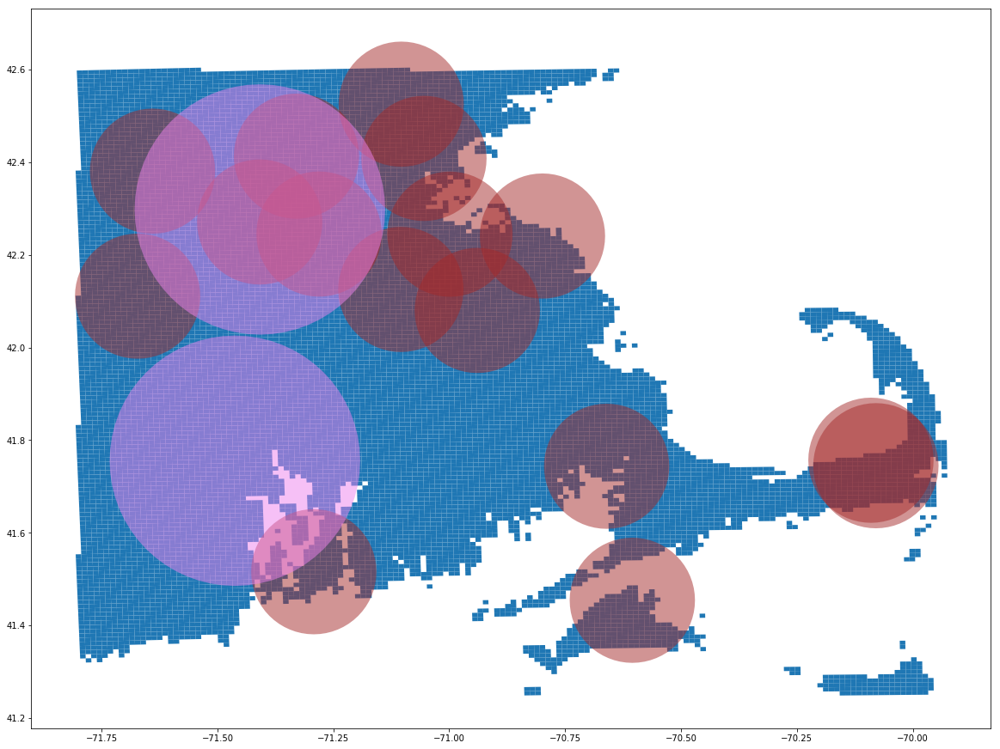

In [79]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
local_eo.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='brown', ax=ax, zorder=5, alpha=0.5)
state_eo.buffer(0.27027027027).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5, alpha=0.5)

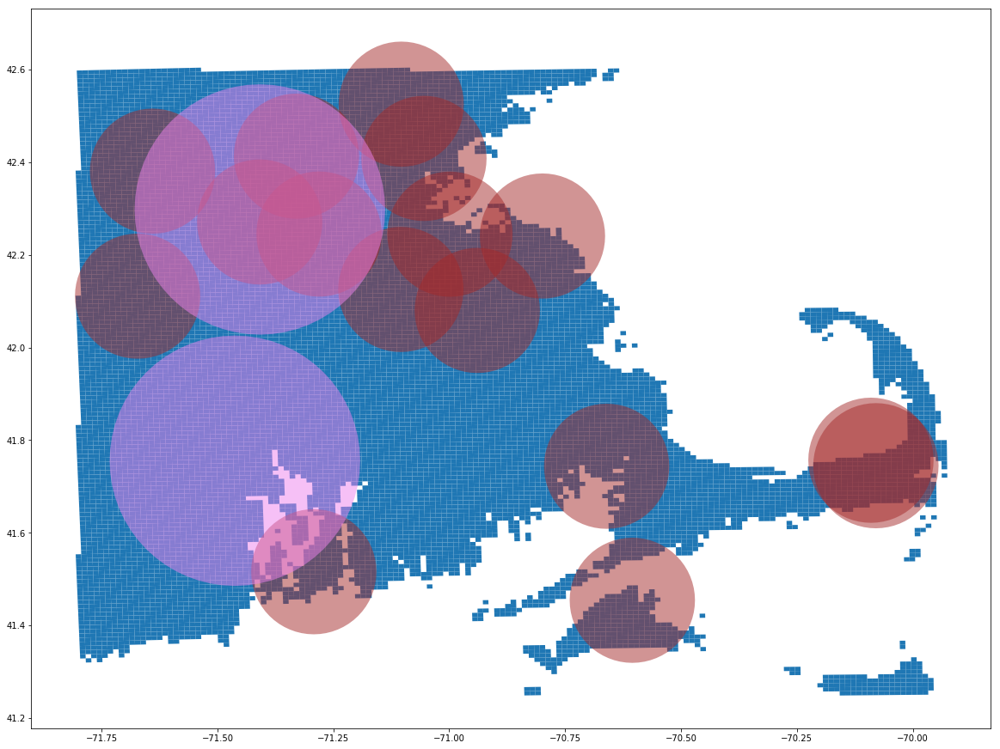

In [80]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax)
eff_lcl_eo.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='brown', ax=ax, zorder=5, alpha=0.5)
eff_stt_eo.buffer(0.27027027027).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5, alpha=0.5)

#Transportation
This includes airfields

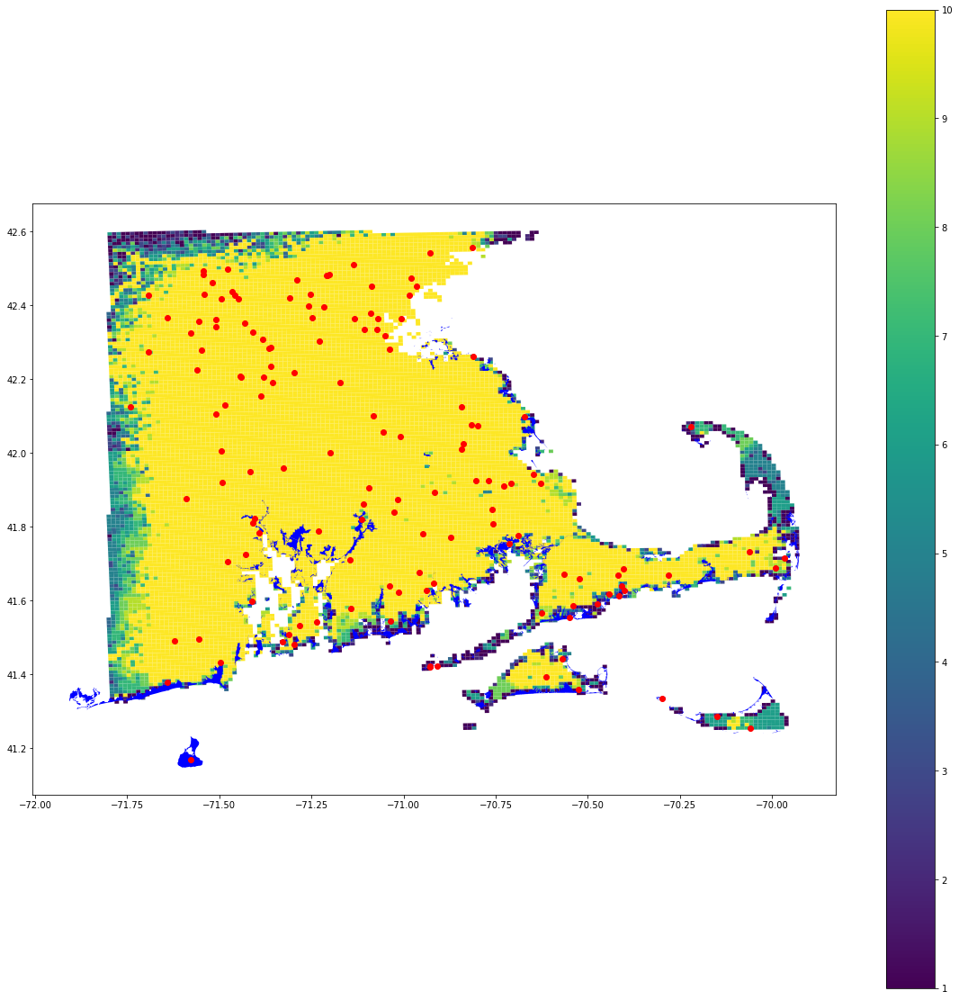

In [81]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Transporta', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)
airfields.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)

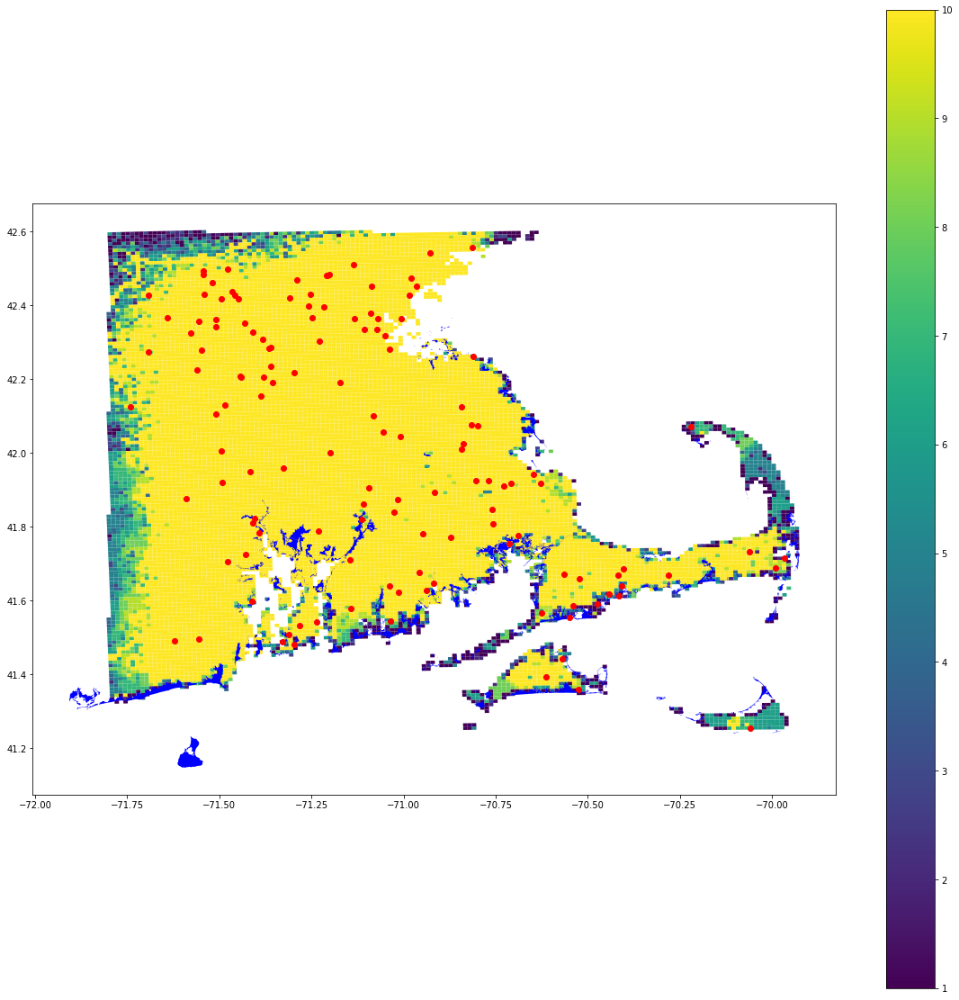

In [82]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Transporta', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)
eff_airfields.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)

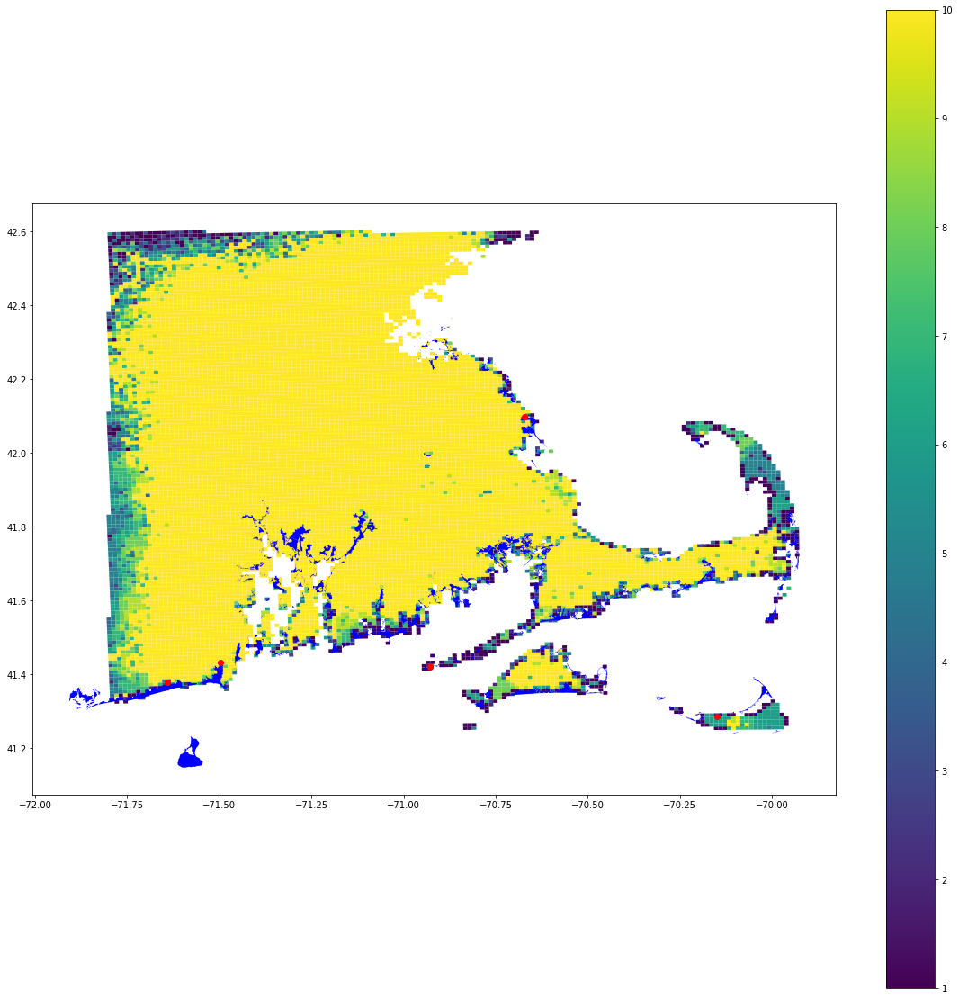

In [83]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Transporta', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)
dead_airfields.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)

#Changes in Map

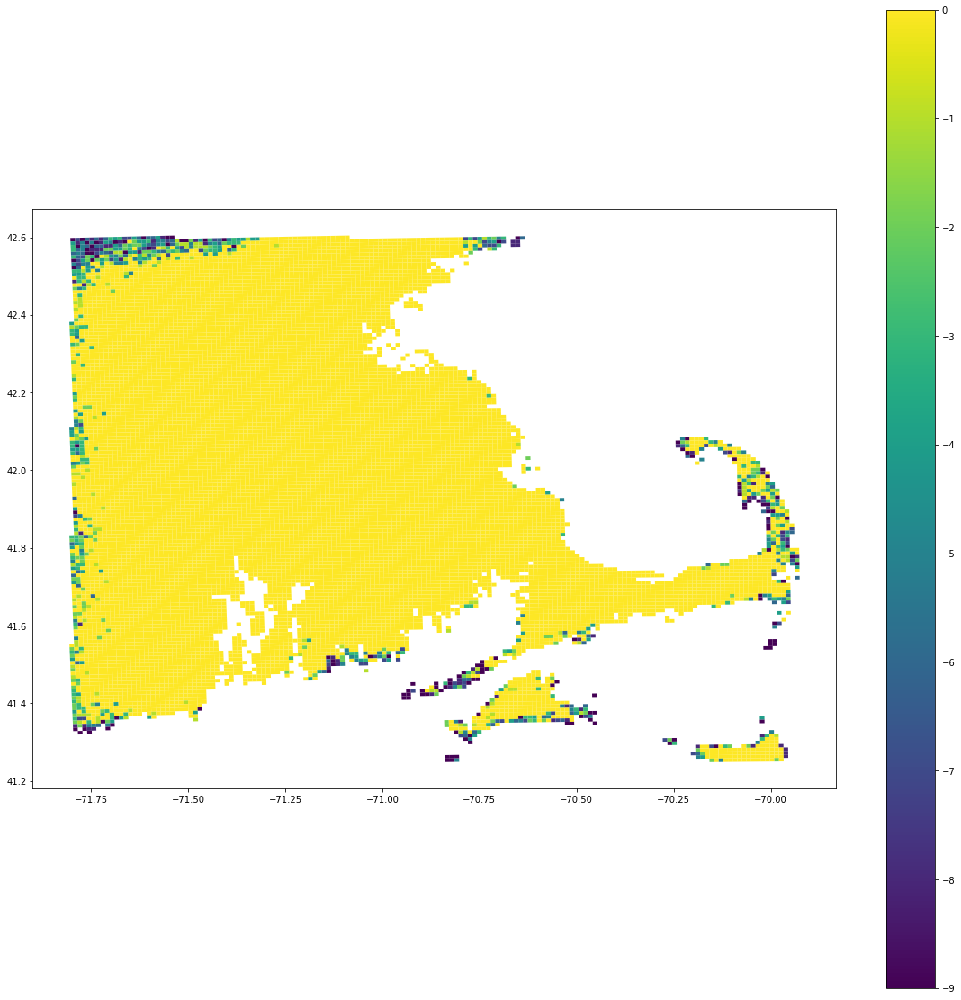

In [84]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
change.plot(ax=ax, column='Health', legend=True)

In [85]:
change.loc[change['Health']!=0]

,Health,Utility,Transporta,geometry
0,-9,3,-2,POLYGON ((-71.79092278136125 42.58943590354409...
1,-7,3,-6,POLYGON ((-71.77874932612048 42.58973201162303...
2,-9,3,-3,POLYGON ((-71.76657568741803 42.59002682737616...
3,-6,2,-2,POLYGON ((-71.75440186615322 42.59032035170287...
4,-8,3,-2,POLYGON ((-71.74222786322531 42.59061258370377...
5,-6,3,-1,POLYGON ((-71.73005367863436 42.59090352427819...
6,-8,3,-2,POLYGON ((-71.71787931507833 42.59119317252686...
7,-6,3,-2,POLYGON ((-71.70570477165785 42.59148152844978...
8,-3,3,0,POLYGON ((-71.69353005017166 42.59176859294621...
9,-4,3,-2,POLYGON ((-71.68135515061971 42.59205436511684...


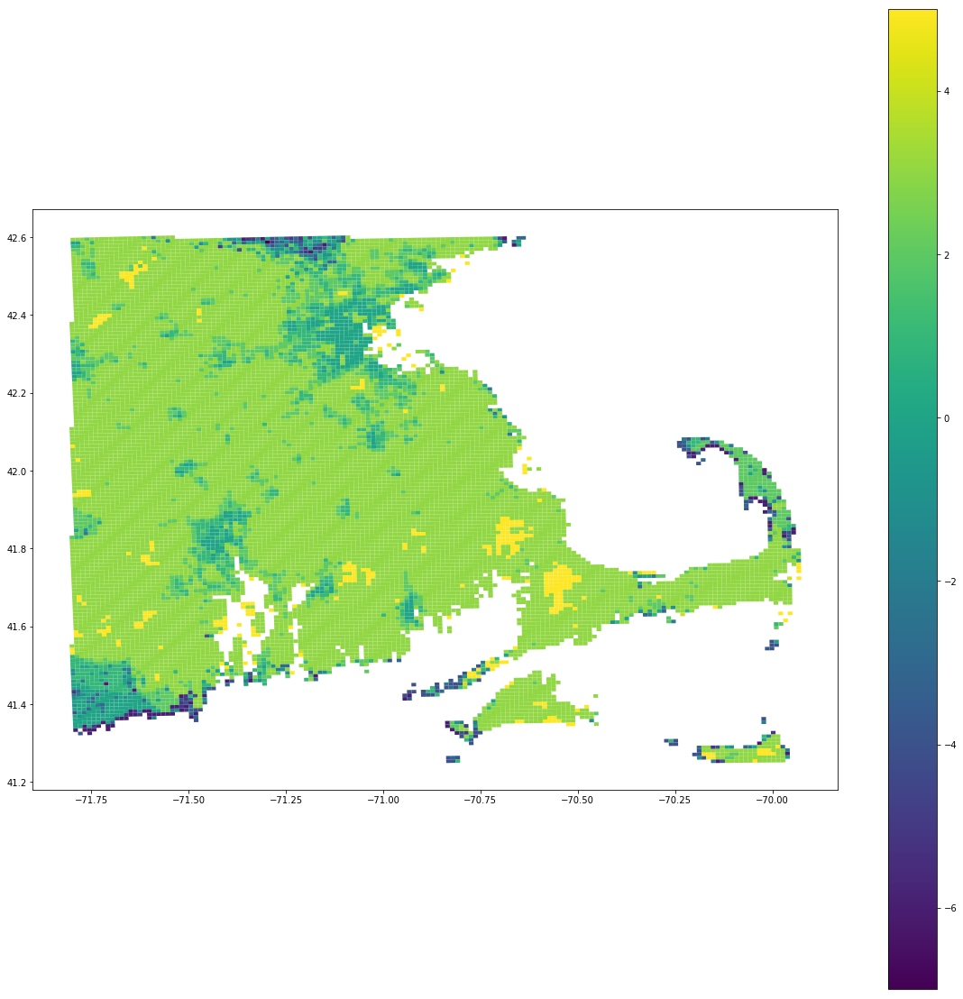

In [86]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
change.plot(ax=ax, column='Utility', legend=True)

In [87]:
change.loc[change['Utility']!=0]

,Health,Utility,Transporta,geometry
0,-9,3,-2,POLYGON ((-71.79092278136125 42.58943590354409...
1,-7,3,-6,POLYGON ((-71.77874932612048 42.58973201162303...
2,-9,3,-3,POLYGON ((-71.76657568741803 42.59002682737616...
3,-6,2,-2,POLYGON ((-71.75440186615322 42.59032035170287...
4,-8,3,-2,POLYGON ((-71.74222786322531 42.59061258370377...
5,-6,3,-1,POLYGON ((-71.73005367863436 42.59090352427819...
6,-8,3,-2,POLYGON ((-71.71787931507833 42.59119317252686...
7,-6,3,-2,POLYGON ((-71.70570477165785 42.59148152844978...
8,-3,3,0,POLYGON ((-71.69353005017166 42.59176859294621...
9,-4,3,-2,POLYGON ((-71.68135515061971 42.59205436511684...


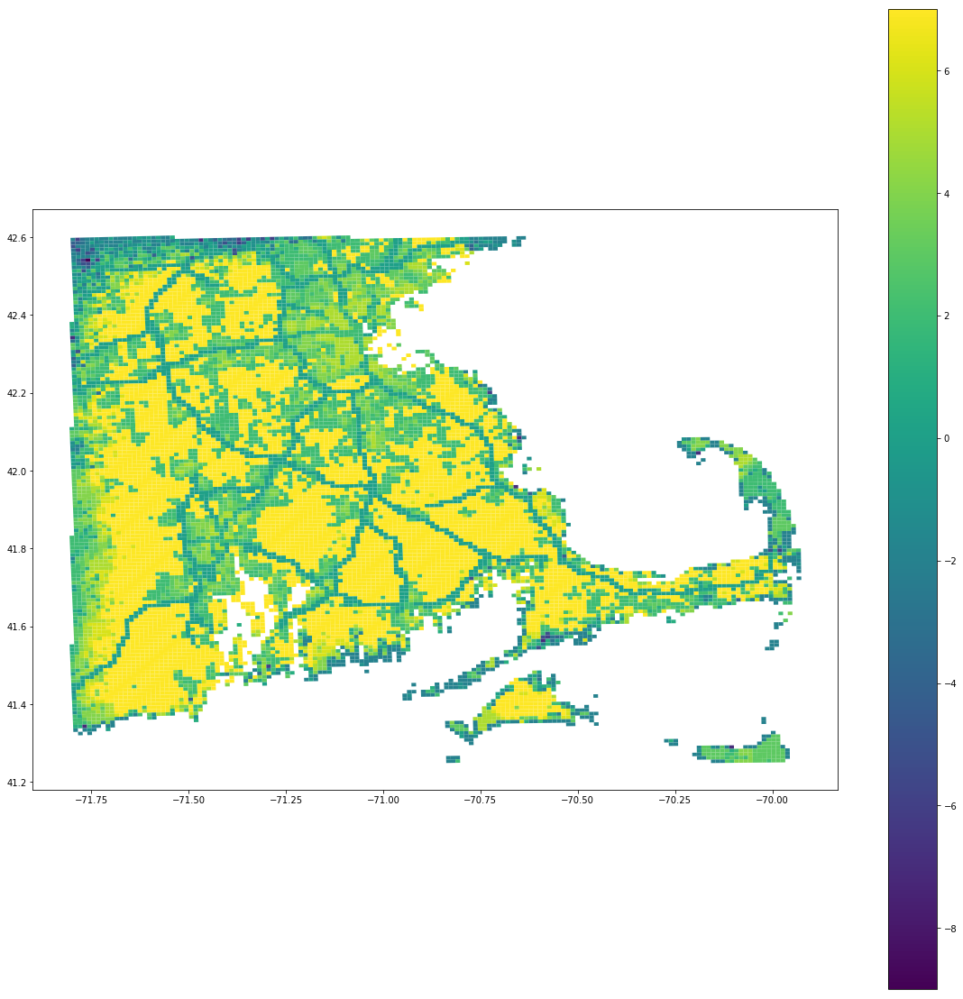

In [88]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
change.plot(ax=ax, column='Transporta', legend=True)

In [89]:
change.loc[change['Transporta']!=0]

,Health,Utility,Transporta,geometry
0,-9,3,-2,POLYGON ((-71.79092278136125 42.58943590354409...
1,-7,3,-6,POLYGON ((-71.77874932612048 42.58973201162303...
2,-9,3,-3,POLYGON ((-71.76657568741803 42.59002682737616...
3,-6,2,-2,POLYGON ((-71.75440186615322 42.59032035170287...
4,-8,3,-2,POLYGON ((-71.74222786322531 42.59061258370377...
5,-6,3,-1,POLYGON ((-71.73005367863436 42.59090352427819...
6,-8,3,-2,POLYGON ((-71.71787931507833 42.59119317252686...
7,-6,3,-2,POLYGON ((-71.70570477165785 42.59148152844978...
9,-4,3,-2,POLYGON ((-71.68135515061971 42.59205436511684...
10,-3,3,-2,POLYGON ((-71.66918007390126 42.59233884496172...


Health:

No one dies at 9-10

7-8 means each person has a .25% chance of dying per turn 

<7 means each person has a .5% chance of dying per turn

Utility:

Small Hospitals need >= 7

Big Hospitals need 9 or 10

Transportation:

10=100% movement speed,

9=90% movement speed

8=80% movement speed

and so on

We are almost gauranteed to have at least 3 days of prep time, and with average rolls, will have 4(3.5555555...)

With average rolls, we will have a catagory 2 hurricane.

Flooding and wind are proportional to the catagory of the hurricane.

Flooding drops all stats by an average of 3 and will not go further in a catagory 2 hurricane.

Wind drops the utility and transportation by 2(?) and drops health by 1, with 1 extra in highly-populated areas.

Wind is more likely to hit areas with greater utility or initial population